# Run Ref

Compare the following 3 runs:
- `Ref`: spinup and run with the original met forcing files (1h time step, i.e., interpolated by the model to 30 minutes)
- `Ref_30min`: spinup and run with the linearly interpolated met forcing files to 30 minutes (took as so by the model)
- `Ref_30_60_min`: start from the `Ref_30min` spinup but force back with the original files (1h) to exacerbate differences
      -> finally not that different 

In [3]:
# Env: sc2_v0
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy import stats
import calendar
import os

In [17]:
site = 'cdp_30_60_min'
site_longname = 'Col de Porte, France'
y_start = 1995
y_end = 2013

# labels = ['Ref', 'Ref_30min', 'Ref_30_60min']
labels = ['Ref', 'Ref_30min']

root_path = '/home/lalandmi/eccc/classic-develop/outputFiles/SnowMIP/'+site+'/'
paths = [root_path+'run_'+label for label in labels]

ds_yr_list = [xr.open_mfdataset(path+'/*_annually.nc').squeeze().load() for path in paths]
ds_mo_list = [xr.open_mfdataset(path+'/*_monthly.nc').squeeze().load() for path in paths]
ds_d_list = [xr.open_mfdataset(path+'/*_daily.nc').squeeze().load() for path in paths]
ds_hh_list = [xr.open_mfdataset(path+'/*_halfhourly.nc').squeeze().load() for path in paths]

In [18]:
path = "/home/lalandmi/eccc/classic-develop/inputFiles/SnowMIP/"+site
rsfile = xr.open_dataset(path+'/rsfile_spinup-final_'+labels[0]+'.nc')

In [19]:
def assign_center_depth(ds, rsfile):
    layer_c = []
    for i in range(len(rsfile.DELZ)):
        if i == 0:
            layer_c.append(rsfile.DELZ.cumsum().values[i]/2)
        else:
            layer_c.append(rsfile.DELZ.cumsum().values[i-1] + rsfile.DELZ.values[i]/2)
    with xr.set_options(keep_attrs=True):
        ds = ds.assign_coords(layer=ds.layer*0+layer_c)
    return ds

In [20]:
for i in range(len(labels)):
    ds_yr_list[i] = assign_center_depth(ds_yr_list[i], rsfile)
    ds_mo_list[i] = assign_center_depth(ds_mo_list[i], rsfile)
    ds_d_list[i] = assign_center_depth(ds_d_list[i], rsfile)
    ds_hh_list[i] = assign_center_depth(ds_hh_list[i], rsfile)

In [11]:
# Paul's SnowMIP data

path_paul = '/home/lalandmi/Dropbox/data/SnowMIP/Paul/CLASS_Results'
label_paul = "SnowMIP"

df_paul = pd.read_csv(path_paul+'/CLASS_sv_REF_cdp_'+str(y_start-1)+'_'+str(y_end+1)+'.txt', delim_whitespace=True)
df_paul.index = pd.to_datetime(df_paul[['year', 'month', 'day', 'hour']]).values
df_paul= df_paul.drop(columns=['year', 'month', 'day', 'hour'])
df_paul.albsn = df_paul.albsn.replace({0 : np.nan})
df_paul.albs = df_paul.albs.replace({0 : np.nan})
df_paul.tsn = df_paul.tsn.replace({-999 : np.nan})
df_paul.tsns = df_paul.tsns.replace({-999 : np.nan})
ds_paul_h = df_paul.to_xarray()
ds_paul_h = ds_paul_h.rename({'index': 'time'})
ds_paul_h.load()

ds_paul_d = ds_paul_h.resample(time='D').mean().load()
ds_paul_d = ds_paul_d.assign_coords(layer=[0.05 , 0.225, 2.225]) # center of Paul's soil layers (DELZ = [0.1, 0.25, 3.75])

In [12]:
# Combine the soil temperature in one variable
ds_paul_d = ds_paul_d.assign(
    tsl=(('layer', 'time'), [
        list(ds_paul_d['tsl:1'].values),
        list(ds_paul_d['tsl:2'].values),
        list(ds_paul_d['tsl:3'].values),
    ])
)

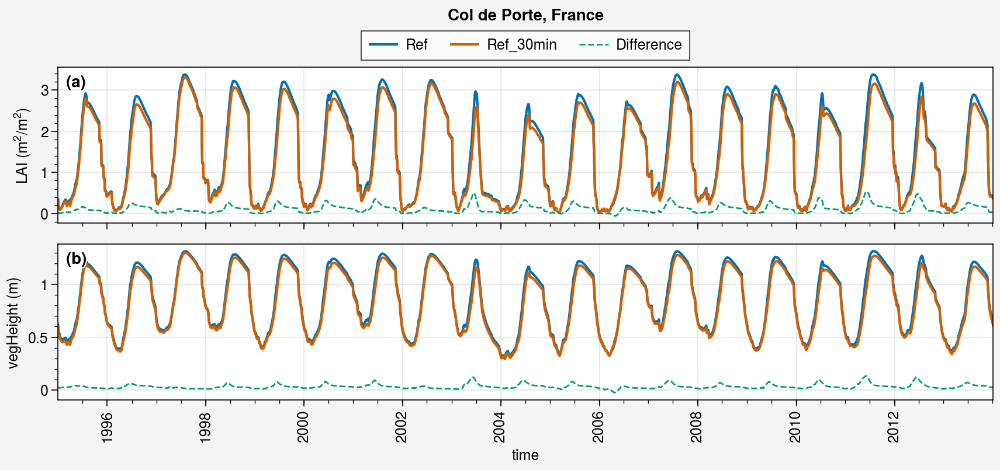

In [32]:
fig, axs = pplt.subplots(ncols=1, nrows=2, refaspect=6, refwidth=8, sharey=0)

for ds_d, label in zip(ds_d_list, labels):
    axs[0].plot(ds_d.lai, label=label)
    axs[1].plot(ds_d.vegHeight, label=label)


axs[0].plot(ds_d_list[0].lai-ds_d_list[1].lai, ls='--', lw=1, label='Difference')
axs[1].plot(ds_d_list[0].vegHeight-ds_d_list[1].vegHeight, ls='--', lw=1, label='Difference')

axs[0].format(ylabel='LAI ('+ds_d_list[0].lai.units+')')
axs[1].format(ylabel='vegHeight ('+ds_d_list[0].vegHeight.units+')')

axs[0].legend(loc='t')

fig.suptitle(site_longname)
fig.format(abc='(a)', abcloc='ul')
fig.save('img/lai_vegHeith_30_60_min.jpg')

Text(0.5, 0.98, 'Col de Porte, France (1995-2013)')

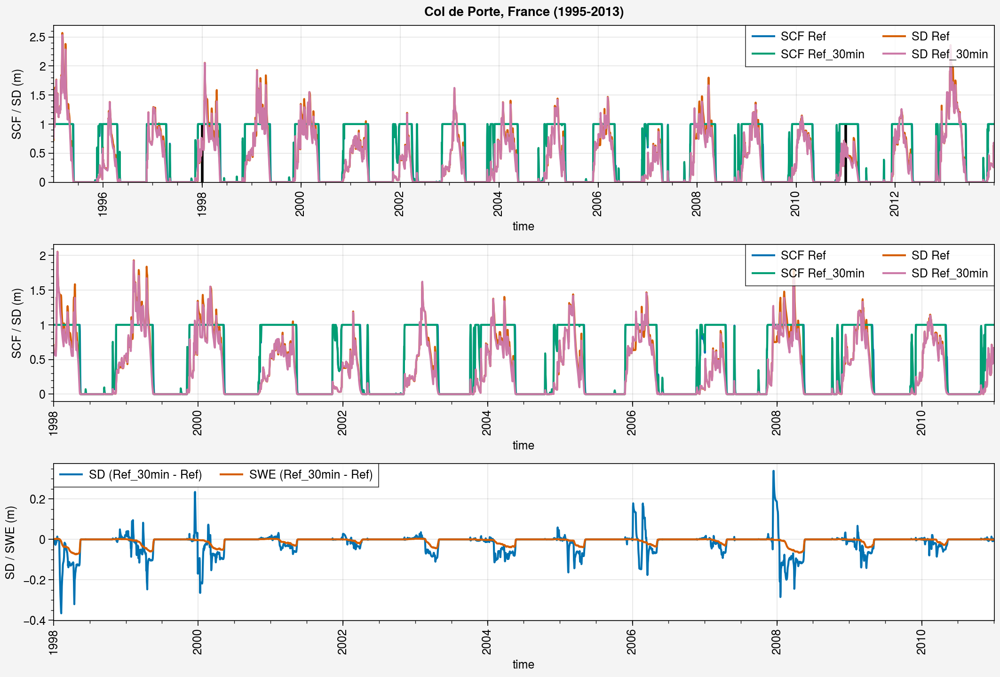

In [33]:
if len(labels) > 1:
    nrows = 3
else: 
    nrows = 2
    
fig, axs = pplt.subplots(ncols=1, nrows=nrows, refaspect=6, refwidth=10, share=0)

##################
### All period ###
##################
start = str(y_start)
end = str(y_end)

for ds_d, label in zip(ds_d_list, labels):
    axs[0].plot(ds_d.snc.sel(time=slice(start,end)), label='SCF '+label)
    axs[0].plot(ds_d.snd.sel(time=slice(start,end)), label='SD '+label)

axs[0].legend(ncols=2, loc='ur')
axs[0].format(
    ylabel='SCF / SD (m)'
)


############
### Zoom ###
############
start = str(y_start+3)
end = str(y_end-3)

for ds_d, label in zip(ds_d_list, labels):
    axs[1].plot(ds_d.snc.sel(time=slice(start,end)), label='SCF '+label)
    axs[1].plot(ds_d.snd.sel(time=slice(start,end)), label='SD '+label)

axs[0].vlines(ds_d_list[0].sel(time=slice(start,end)).time[0], ds_d_list[0].snc.min(), ds_d_list[0].snc.max(), color='k', lw=2)
axs[0].vlines(ds_d_list[0].sel(time=slice(start,end)).time[-1], ds_d_list[0].snc.min(), ds_d_list[0].snc.max(), color='k', lw=2)

axs[1].legend(ncols=2, loc='ur')
axs[1].format(
    ylabel='SCF / SD (m)'
)

if nrows == 3:
    #####################
    ### SWE / SD diff ###
    #####################
    axs[2].plot((ds_d_list[1]-ds_d_list[0]).snd.sel(time=slice(start,end)), label='SD ('+labels[1]+' - '+labels[0]+')')
    axs[2].plot(((ds_d_list[1]-ds_d_list[0]).snw*1e-3).sel(time=slice(start,end)), label='SWE ('+labels[1]+' - '+labels[0]+')')
    
    axs[2].legend(ncols=2)
    axs[2].format(
        ylabel='SD / SWE (m)'
    )

fig.suptitle(site_longname+' ('+str(y_start)+'-'+str(y_end)+')')


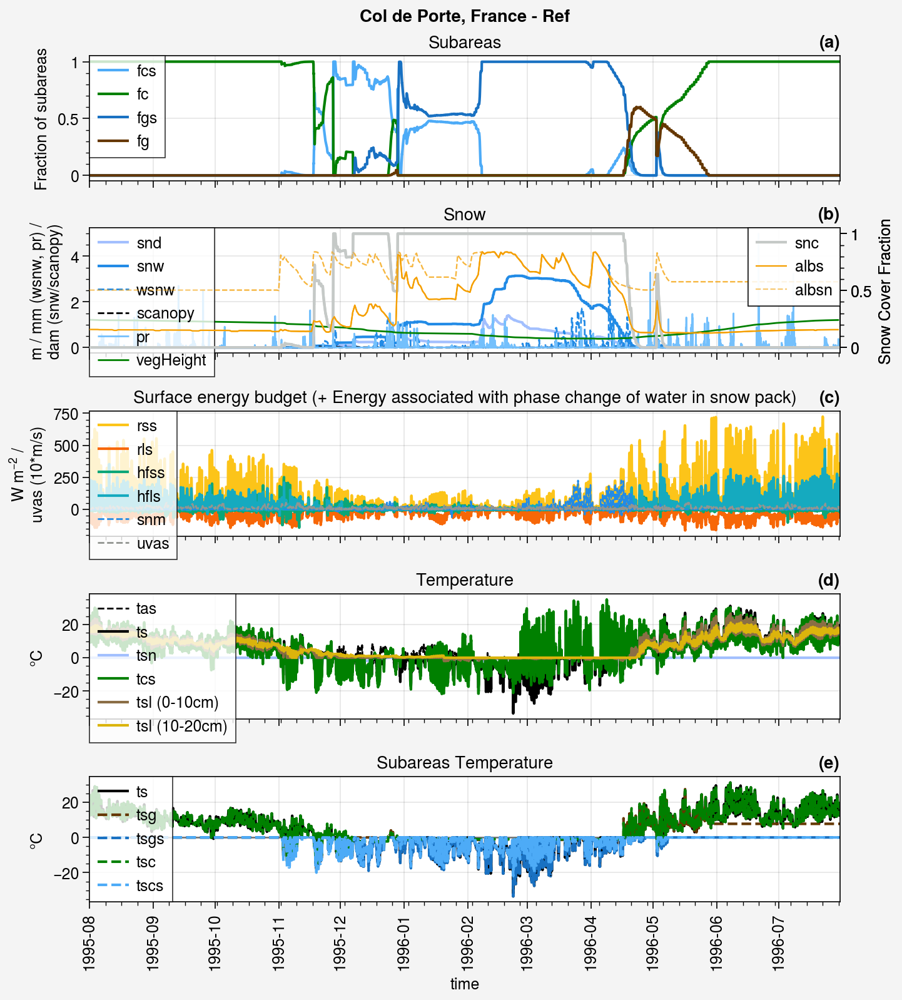

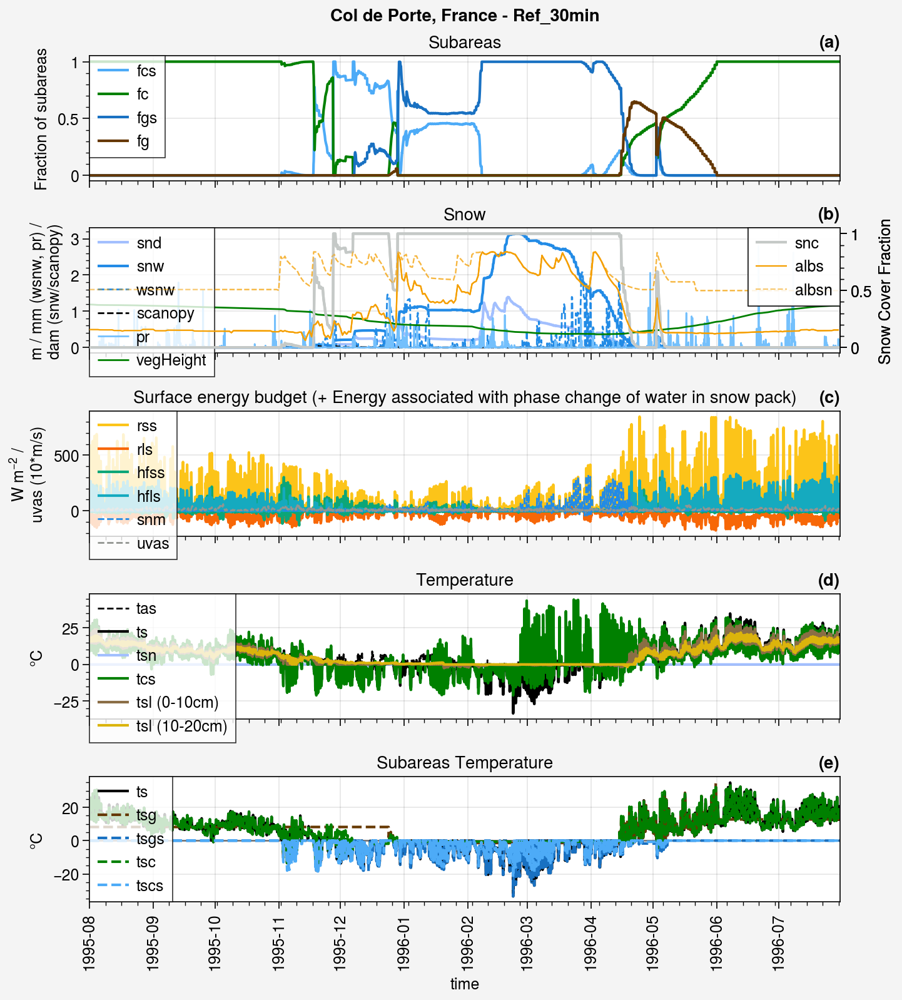

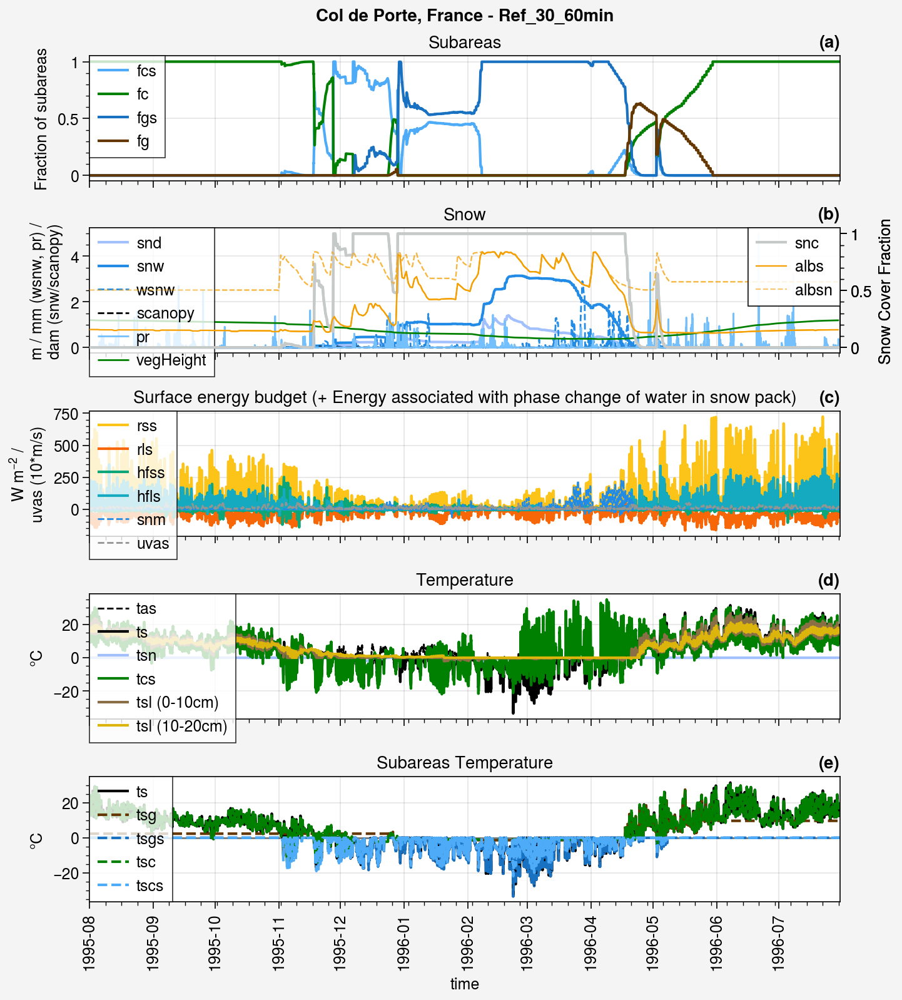

In [15]:
for period in [
    slice(str(y_start)+'-08-01',str(y_start+1)+'-07-30'),
]:

    collabels = labels
    for i, (ds, ds_d) in enumerate(zip(ds_hh_list, ds_d_list)):
        
        fig, axs = pplt.subplots(ncols=1, nrows=5, refaspect=6, refwidth=6, sharey=0)
    
        #############################
        ### Fractions of subareas ###
        #############################

        variables = {
            'fcs': {'color': 'blue4', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fc': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fgs': {'color': 'blue8', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fg': {'color': 'brown', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[0]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='Fraction of subareas', title='Subareas', ylim=(-0.05,1.05))

        ##############################
        ### Snow related variables ###
        ##############################

        variables = {
            'snd': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snw': {'color': 'blue6', 'ls': '-', 'lw': 1.5, 'factor': 1e-3*10, 'shift': 0},
            'wsnw': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'scanopy': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1e-3*10, 'shift': 0},
            'pr': {'color': 'blue3', 'ls': '-', 'lw': 1, 'factor': 500, 'shift': 0},
        #     'albs': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
    #         'mrron': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        #     'snm': {'color': 'blue8', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
        }

        ax = axs[1]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.plot(ds_d.vegHeight.sel(time=period), label=ds_d.vegHeight.name, color='green', ls='-', lw=1)
        # ax.plot(ds_d.lai.sel(time=period), label='LAI', color='green', ls='-', lw=1)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='m / mm (wsnw, pr) /\ndam (snw/scanopy)', title='Snow')

        variables = {
            'snc': {'color': 'silver', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }
        ox = ax.alty(label='Snow Cover Fraction')
        for key in variables.keys():
            ox.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ox.plot(ds_d.albs.sel(time=period), label='albs', color='yellow7', ls='-', lw=0.8)
        ox.plot(ds_d.albsn.sel(time=period), label='albsn', color='yellow7', ls='--', lw=0.8, alpha=0.5)
        ox.legend(ncols=1, loc='ur')
        ox.format(ylim=(-0.05,1.05))


        ##############################
        ### Surface energy budget ###
        ##############################

        variables = {
            'rss': {'color': 'yellow5', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'rls': {'color': 'orange7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        #     'rlds': {'color': 'orange7', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'hfss': {'color': 'teal7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'hfls': {'color': 'cyan6', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snm': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'uvas': {'color': 'gray', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        }

        ax = axs[2]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).time[0], ds.sel(time=period).time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='W m$^{-2}$ /\nuvas (10*m/s)', title='Surface energy budget (+ Energy associated with phase change of water in snow pack)')


        ###################
        ### Temperature ###
        ###################

        variables = {
            'tas': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 273.15},
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},    
            'tsn': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'tcs': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[3]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.plot((ds.tsl-273.15).sel(time=period).isel(layer=0), label=ds.tsl.name+' (0-10cm)', color='dirt')
        ax.plot((ds.tsl-273.15).sel(time=period).isel(layer=1), label=ds.tsl.name+' (10-20cm)', color='gold')
        # ax.plot(ds_h_eval_menard2019.ts.sel(time=period), color='red', label='ts obs')
        ax.hlines(0, ds.sel(time=period).time[0], ds.sel(time=period).time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Temperature')

        


        ############################
        ### Subareas Temperature ###
        ############################

        variables = {
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},

            'tsg': {'color': 'brown', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsgs': {'color': 'blue8', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsc': {'color': 'green', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tscs': {'color': 'blue4', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
        }

        ax = axs[4]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).time[0], ds.sel(time=period).time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Subareas Temperature')

        fig.suptitle(site_longname+' - '+collabels[i])
        fig.format(abc='(a)', abcloc='r')
        # fig.save('img/'+labels[i]+'_hh.jpg')

## Compare with obs

In [36]:
path_menard2019 = '/home/lalandmi/Dropbox/data/ESM-SnowMIP_all'

ds_h_eval_menard2019 = xr.open_dataset(path_menard2019+'/obs_insitu_cdp_'+str(y_start-1)+'_'+str(y_end+1)+'.nc').load()
ds_d_eval_menard2019 = ds_h_eval_menard2019.resample(time='D').mean().load()
ds_h_eval_menard2019

<xarray.Dataset> Size: 8MB
Dimensions:   (time: 175320, sdepth: 3)
Coordinates:
  * time      (time) datetime64[ns] 1MB 1994-10-01T01:00:00 ... 2014-10-01
  * sdepth    (sdepth) float32 12B 0.1 0.2 0.5
Data variables:
    albs      (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snd_auto  (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snd_man   (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snw_auto  (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snw_man   (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    ts        (time) float32 701kB 11.12 9.668 8.029 ... 7.532 7.532 8.029
    tsl       (time, sdepth) float32 2MB 11.95 12.28 12.23 ... 12.95 12.83 12.8

In [38]:
ds_h_met = xr.open_dataset(path_menard2019+'/met_insitu_cdp_'+str(y_start-1)+'_'+str(y_end+1)+'.nc').load()

In [39]:
ds_hh_list[0].rsds.sel(time=period).mean()

<xarray.DataArray 'rsds' ()> Size: 8B
array(128.16048473)

In [40]:
ds_h_met.SWdown.sel(time=period).mean()

<xarray.DataArray 'SWdown' ()> Size: 4B
array(128.16049, dtype=float32)

In [133]:
299730/60

4995.5

In [141]:
ds_hh_list[0].rsds.sel(time=period).integrate(coord='time', datetime_unit='h')

<xarray.DataArray 'rsds' ()> Size: 8B
array(4995.5000549)

In [143]:
ds_hh_list[1].time[0]

<xarray.DataArray 'time' ()> Size: 8B
array('1995-01-01T00:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 8B 1995-01-01
Attributes:
    long_name:  time

In [145]:
ds_hh_list[1].rsds.sel(time=period).integrate(coord='time', datetime_unit='s')

<xarray.DataArray 'rsds' ()> Size: 8B
array(17983800.19279718)

In [138]:
ds_h_met.SWdown.sel(time=period).integrate(coord='time', datetime_unit='h')

<xarray.DataArray 'SWdown' ()> Size: 8B
array(4995.49997389)

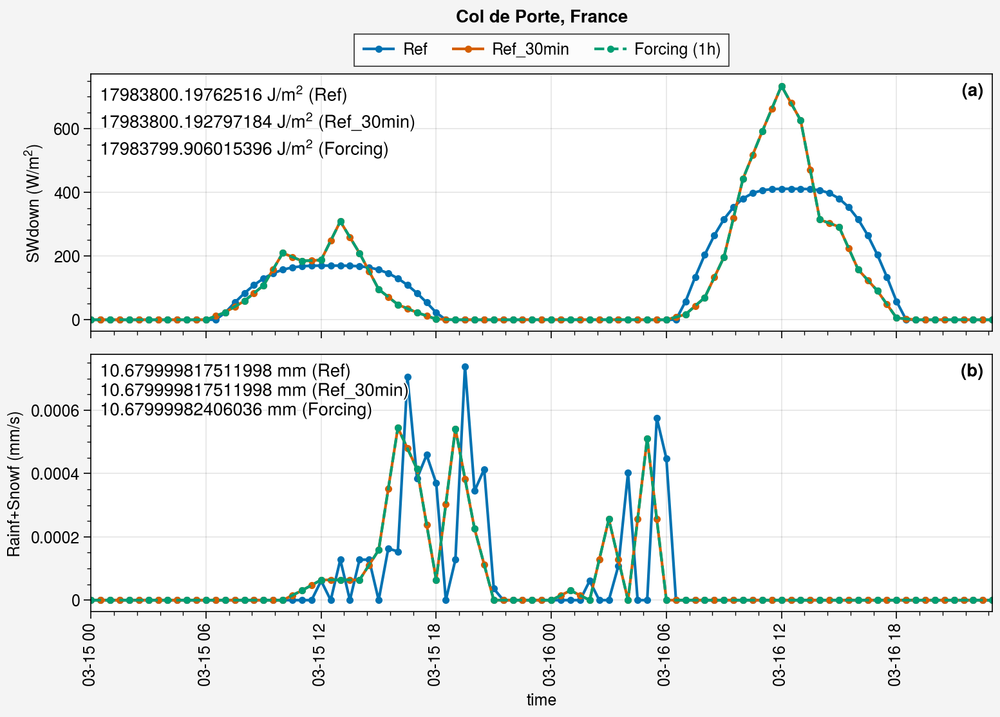

In [169]:
%matplotlib inline
fig, axs = pplt.subplots(nrows=2, refwidth=7, refaspect=3.5, sharey=0)
period=slice('1995-03-15', '1995-03-16')
axs[0].plot(ds_hh_list[0].rsds.sel(time=period), marker='.', label='Ref')
axs[0].plot(ds_hh_list[1].rsds.sel(time=period), marker='.', label='Ref_30min')
axs[0].plot(ds_h_met.SWdown.sel(time=period), marker='.', ls='--', label='Forcing (1h)')
axs[0].format(
    ylabel='SWdown (W/m$^2$)',
    ultitle=str(ds_hh_list[0].rsds.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' J/m$^2$ (Ref)\n'\
            +str(ds_hh_list[1].rsds.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' J/m$^2$ (Ref_30min)\n'\
            +str(ds_h_met.SWdown.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' J/m$^2$ (Forcing)'\
)
axs[0].legend(loc='t')

axs[1].plot(ds_hh_list[0].pr.sel(time=period), marker='.', label='Ref')
axs[1].plot(ds_hh_list[1].pr.sel(time=period), marker='.', label='Ref_30min')
axs[1].plot((ds_h_met.Rainf+ds_h_met.Snowf).sel(time=period), marker='.', ls='--', label='Forcing (1h)')
axs[1].format(
    ylabel='Rainf+Snowf (mm/s)',
    ultitle=str(ds_hh_list[0].pr.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Ref)\n'\
            +str(ds_hh_list[1].pr.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Ref_30min)\n'\
            +str((ds_h_met.Rainf+ds_h_met.Snowf).sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Forcing)'\
)

fig.suptitle(site_longname)
fig.format(abc='(a)', abcloc='ur')
fig.save('img/forcing_30_60_min.jpg')

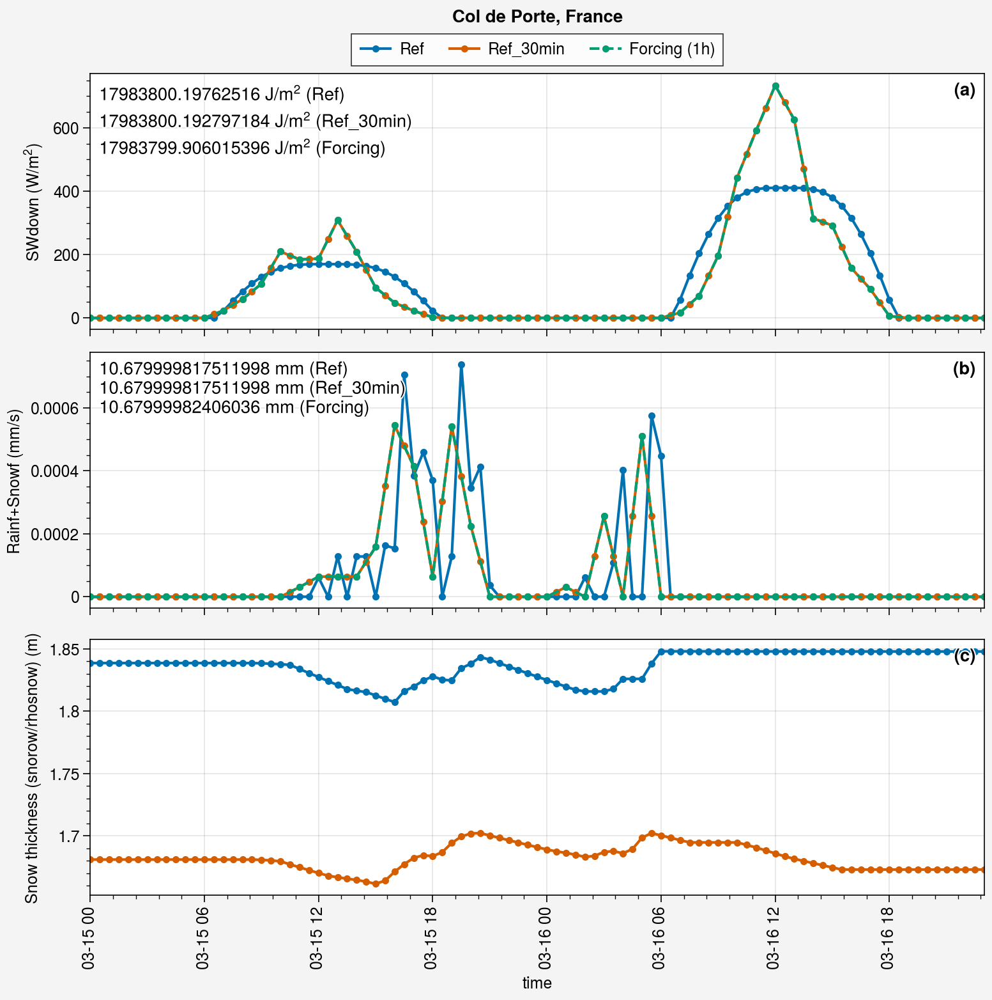

In [173]:
%matplotlib inline
fig, axs = pplt.subplots(nrows=3, refwidth=7, refaspect=3.5, sharey=0)
period=slice('1995-03-15', '1995-03-16')
axs[0].plot(ds_hh_list[0].rsds.sel(time=period), marker='.', label='Ref')
axs[0].plot(ds_hh_list[1].rsds.sel(time=period), marker='.', label='Ref_30min')
axs[0].plot(ds_h_met.SWdown.sel(time=period), marker='.', ls='--', label='Forcing (1h)')
axs[0].format(
    ylabel='SWdown (W/m$^2$)',
    ultitle=str(ds_hh_list[0].rsds.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' J/m$^2$ (Ref)\n'\
            +str(ds_hh_list[1].rsds.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' J/m$^2$ (Ref_30min)\n'\
            +str(ds_h_met.SWdown.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' J/m$^2$ (Forcing)'\
)
axs[0].legend(loc='t')

axs[1].plot(ds_hh_list[0].pr.sel(time=period), marker='.', label='Ref')
axs[1].plot(ds_hh_list[1].pr.sel(time=period), marker='.', label='Ref_30min')
axs[1].plot((ds_h_met.Rainf+ds_h_met.Snowf).sel(time=period), marker='.', ls='--', label='Forcing (1h)')
axs[1].format(
    ylabel='Rainf+Snowf (mm/s)',
    ultitle=str(ds_hh_list[0].pr.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Ref)\n'\
            +str(ds_hh_list[1].pr.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Ref_30min)\n'\
            +str((ds_h_met.Rainf+ds_h_met.Snowf).sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Forcing)'\
)

axs[2].plot(ds_hh_list[0].snd.sel(time=period), marker='.', label='Ref')
axs[2].plot(ds_hh_list[1].snd.sel(time=period), marker='.', label='Ref_30min')
# axs[2].plot(ds.snd.sel(time=period), marker='.', ls='--', label='Forcing (1h)')
# axs[2].format(
#     ylabel='Rainf+Snowf (mm/s)',
#     ultitle=str(ds_hh_list[0].pr.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Ref)\n'\
#             +str(ds_hh_list[1].pr.sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Ref_30min)\n'\
#             +str((ds_h_met.Rainf+ds_h_met.Snowf).sel(time=period).integrate(coord='time', datetime_unit='s').values)+' mm (Forcing)'\
# )

fig.suptitle(site_longname)
fig.format(abc='(a)', abcloc='ur')
# fig.save('img/forcing_30_60_min.jpg')

<string>:6: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.


Text(0.5, 1.0, 'Col de Porte, France')

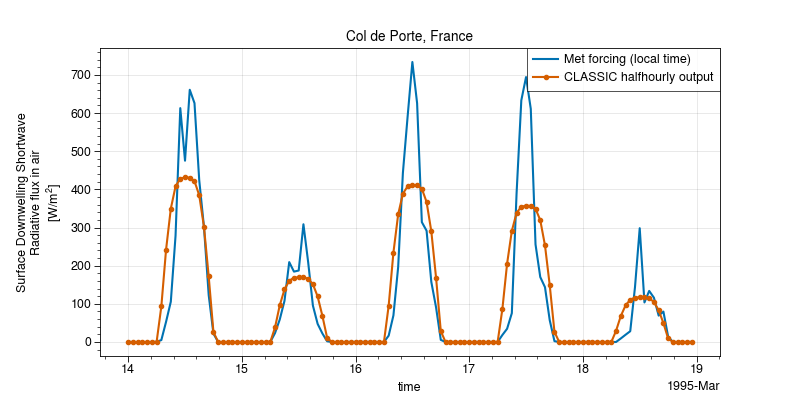

In [49]:
%matplotlib widget
ds_h_met.SWdown.sel(time=period).plot(figsize=(8,4), label='Met forcing (local time)')
# ds_hh_list[0].tas.sel(time=period).plot(marker='.')
ds_hh_list[0].rsds.sel(time=period).resample(time='H').mean().plot(marker='.', label='CLASSIC halfhourly output')
plt.legend()
plt.title(site_longname)

<string>:6: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.


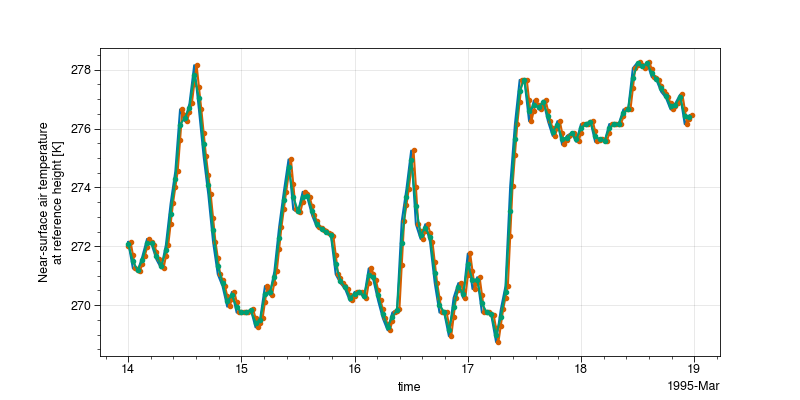

In [52]:
%matplotlib widget
period=slice('1995-03-14', '1995-03-18')
ds_h_met.Tair.sel(time=period).plot(figsize=(8,4))
ds_hh_list[0].tas.sel(time=period).plot(marker='.')
ds_hh_list[0].tas.sel(time=period).resample(time='H').mean().plot(marker='.')

<string>:6: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
<string>:6: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.


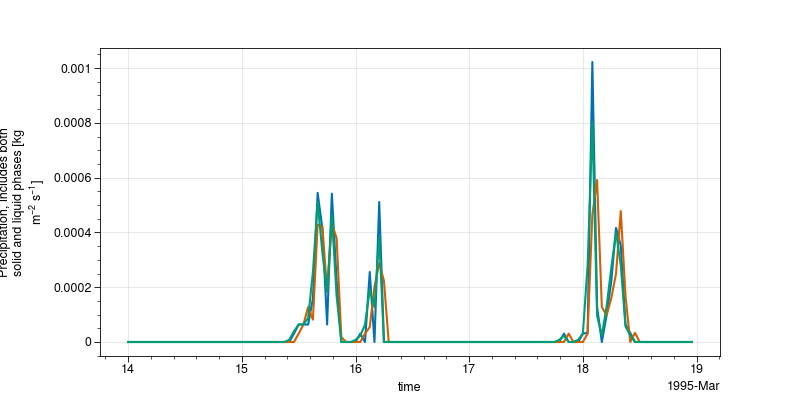

In [54]:
%matplotlib widget
period=slice('1995-03-14', '1995-03-18')
(ds_h_met.Rainf + ds_h_met.Snowf).sel(time=period).plot(figsize=(8,4))
# ds_hh_list[0].pr.sel(time=period).plot()
ds_hh_list[0].pr.sel(time=period).resample(time='H').mean().plot()
ds_hh_list[1].pr.sel(time=period).resample(time='H').mean().plot()

<string>:6: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.


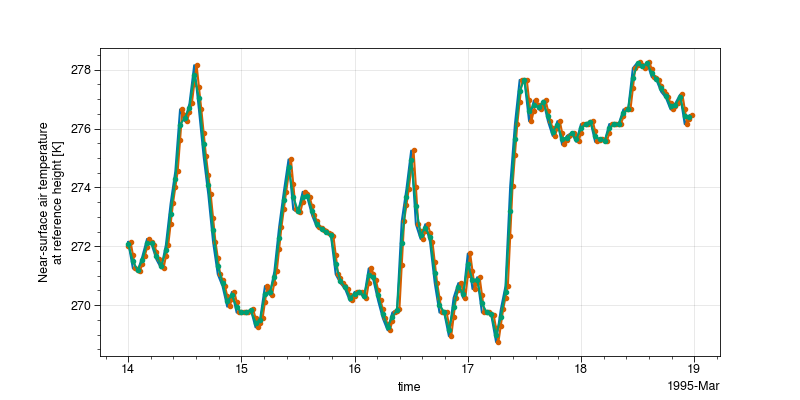

In [55]:
%matplotlib widget
period=slice('1995-03-14', '1995-03-18')
ds_h_met.Tair.sel(time=period).plot(figsize=(8,4))
ds_hh_list[0].tas.sel(time=period).plot(marker='.')
ds_hh_list[0].tas.sel(time=period).resample(time='H').mean().plot(marker='.')

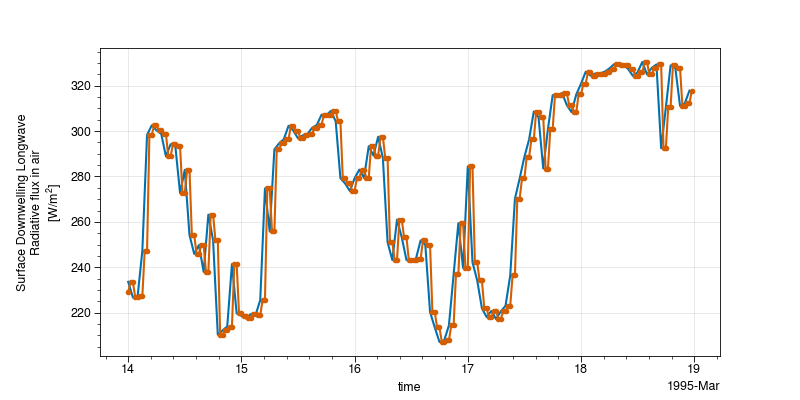

In [56]:
%matplotlib widget
period=slice('1995-03-14', '1995-03-18')
ds_h_met.LWdown.sel(time=period).plot(figsize=(8,4))
ds_hh_list[0].rlds.sel(time=period).plot(marker='.')
# ds_hh_list[0].rlds.sel(time=period).resample(time='H').mean().plot(marker='.')

In [60]:
tot_year = y_end - y_start + 1
gap = 2
years = pplt.arange(y_start, y_end)
years

array([1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005,
       2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013])

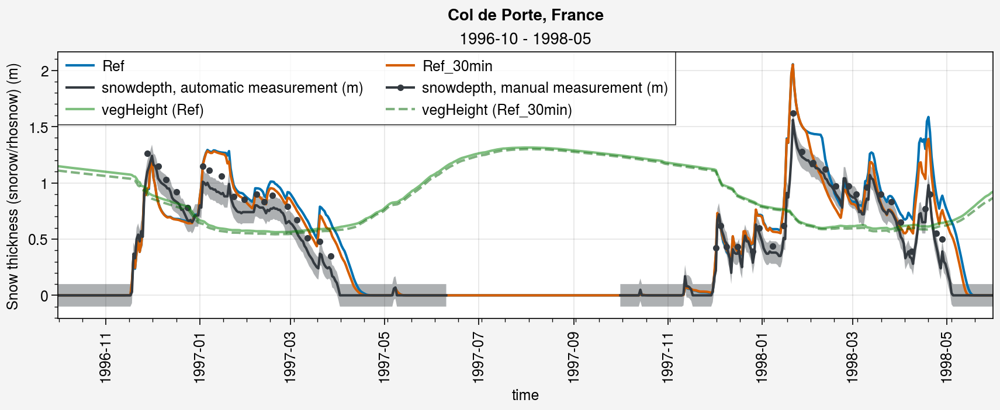

In [200]:
%matplotlib inline

color_obs = 'gray8'


fig, axs = pplt.subplots(nrows=1, refaspect=3.5, refwidth=8)

period=slice('1996-10','1998-05')

# Simus
for ds_d, label in zip(ds_d_list, labels):
    axs[0].plot(ds_d.snd.sel(time=period), label=label)

# Obs
shadedata = np.concatenate((
    np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values+0.1, axis=0),
    np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values-0.1, axis=0),), axis=0)
axs[0].plot(ds_d_eval_menard2019.snd_auto.sel(time=period), shadedata=shadedata, color=color_obs)
axs[0].plot(ds_d_eval_menard2019.snd_man.sel(time=period), marker='.', color=color_obs)

# Veg
axs[0].plot(ds_d_list[0].vegHeight.sel(time=period), label='vegHeight (Ref)', color='green', alpha=0.5)
axs[0].plot(ds_d_list[1].vegHeight.sel(time=period), label='vegHeight (Ref_30min)', color='darkgreen', alpha=0.5, ls='--')

axs[0].legend(loc='ul', ncols=2)
axs[0].format(title=period.start+' - '+period.stop)



# # Simus
# for ds_d, label in zip(ds_d_list, labels):
#     axs[1].plot(ds_d.gpp.sel(time=period), label=label)

# # Simus
# for ds_d, label in zip(ds_d_list, labels):
#     axs[2].plot(ds_d.nep.sel(time=period), label=label)



fig.suptitle(site_longname)
# fig.format(abc='(a)', abcloc='ur')
fig.save('img/snow_30_60_min.jpg')

In [193]:
ds_d_list[0].

<xarray.Dataset> Size: 6MB
Dimensions:     (time: 6940, layer: 20)
Coordinates:
  * time        (time) datetime64[ns] 56kB 1995-01-01 1995-01-02 ... 2013-12-31
  * layer       (layer) float64 160B 0.05 0.15 0.25 0.35 ... 8.9 18.9 41.4 58.9
Data variables: (12/50)
    longitude   float64 8B 5.77
    latitude    float64 8B 45.3
    actlyr      (time) float64 56kB 61.4 61.4 61.39 61.39 ... 61.4 61.4 61.4
    albs        (time) float64 56kB 0.8391 0.8392 0.8366 ... 0.7547 0.7378
    albsir      (time) float64 56kB 0.7292 0.7294 0.7262 ... 0.6619 0.6376
    albsn       (time) float64 56kB 0.8398 0.84 0.8368 ... 0.8062 0.8214 0.7955
    ...          ...
    tsl         (time, layer) float64 1MB 273.2 273.9 274.1 ... 278.8 278.8
    tsn         (time) float64 56kB 272.1 271.9 271.7 ... 273.2 272.6 271.8
    vegHeight   (time) float64 56kB 0.6181 0.6061 0.5949 ... 0.6352 0.6287
    wsnw        (time) float64 56kB 0.0 0.0 0.0 0.0 ... 0.2316 0.0004959 0.0
    wtd         (time) float64 56kB 9.999e+03 9.999e+03 ... 9.999e+03 9.999e+03
    zpond       (time) float64 56kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
Attributes:
    title:        CLASSIC output file
    timestamp:    20240408 1445
    Conventions:  COARDS
    node_offset:  1
    Comment:       run Ref

### SD

In [61]:
ds_d_eval_menard2019

<xarray.Dataset> Size: 321kB
Dimensions:   (sdepth: 3, time: 7306)
Coordinates:
  * sdepth    (sdepth) float32 12B 0.1 0.2 0.5
  * time      (time) datetime64[ns] 58kB 1994-10-01 1994-10-02 ... 2014-10-01
Data variables:
    albs      (time) float32 29kB nan nan nan nan ... 0.232 0.2152 0.2063 nan
    snd_auto  (time) float32 29kB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 nan
    snd_man   (time) float32 29kB nan nan nan nan nan ... nan nan nan nan nan
    snw_auto  (time) float32 29kB nan nan nan nan nan ... 0.0 0.0 0.0 0.0 nan
    snw_man   (time) float32 29kB nan nan nan nan nan ... nan nan nan nan nan
    ts        (time) float32 29kB 10.98 10.66 6.542 5.571 ... 9.938 10.5 8.029
    tsl       (time, sdepth) float32 88kB 12.46 12.15 12.26 ... 12.95 12.83 12.8

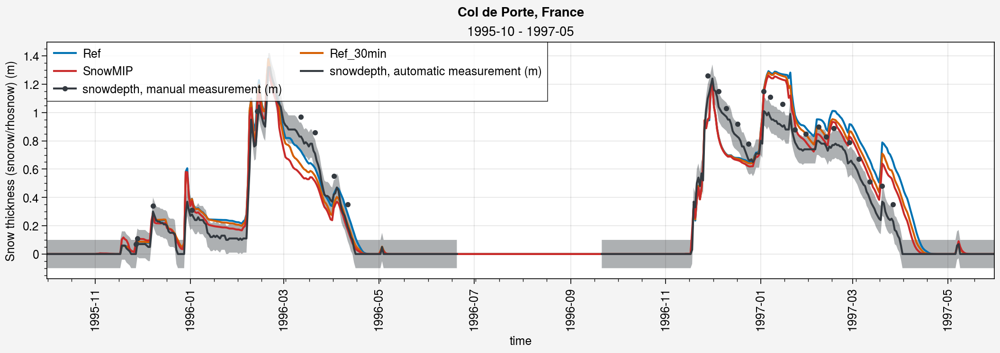

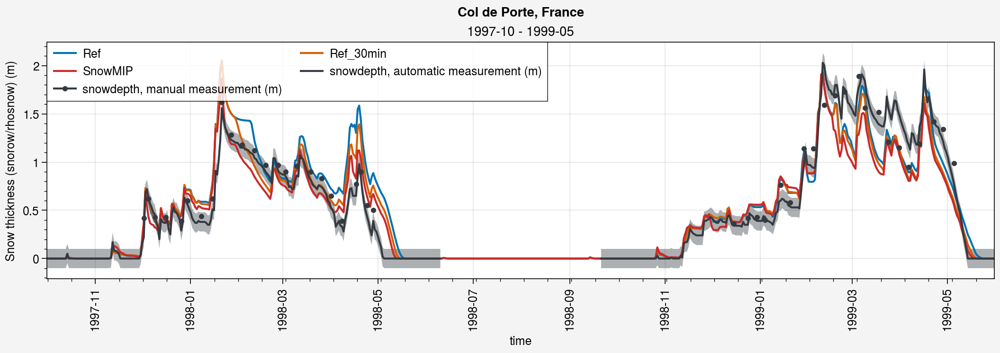

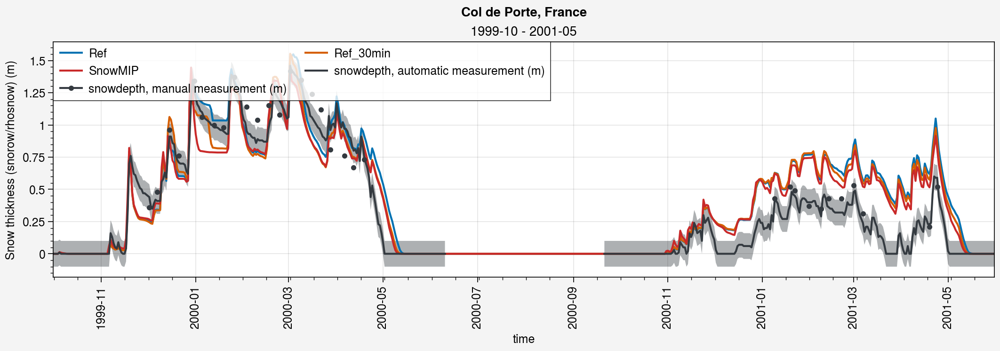

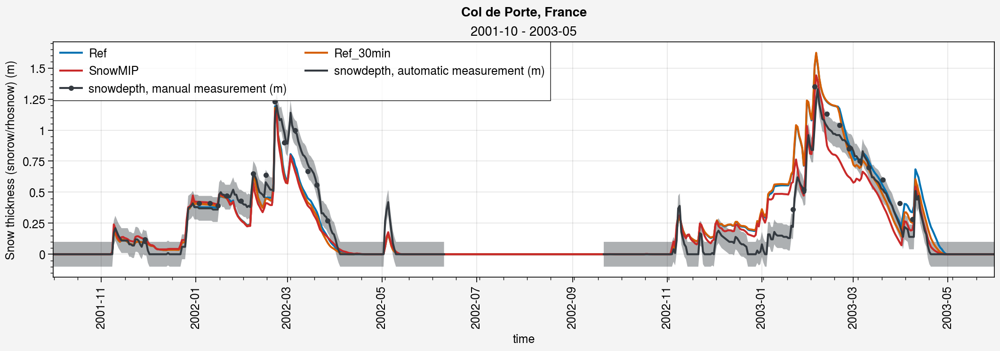

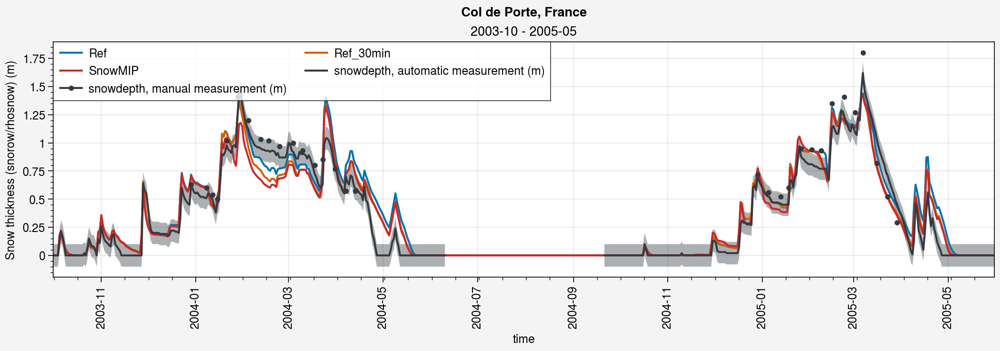

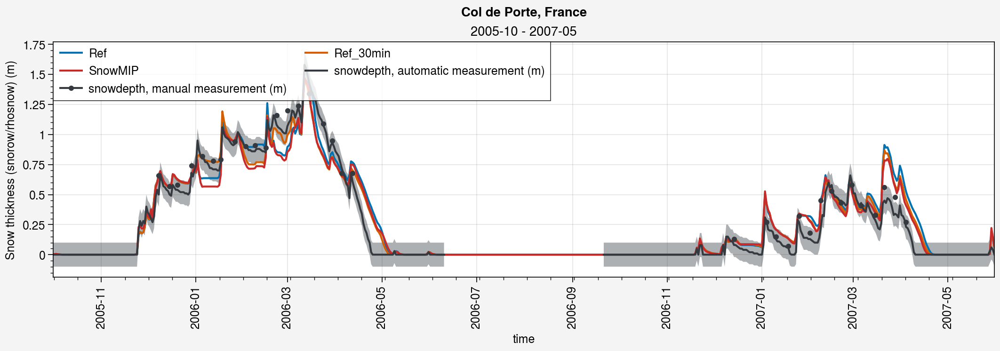

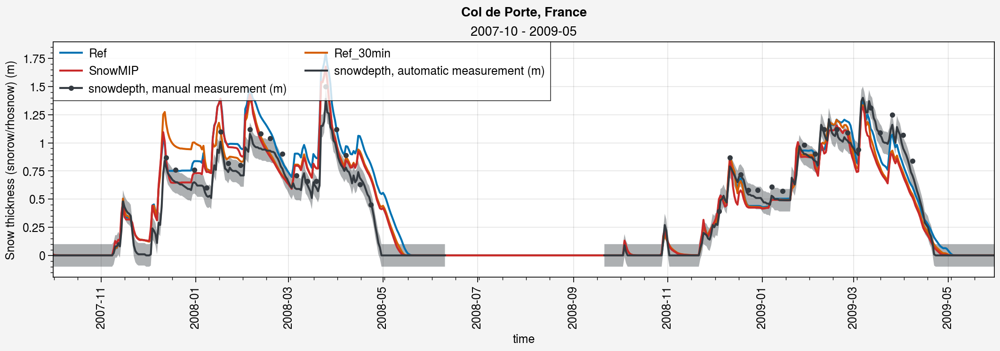

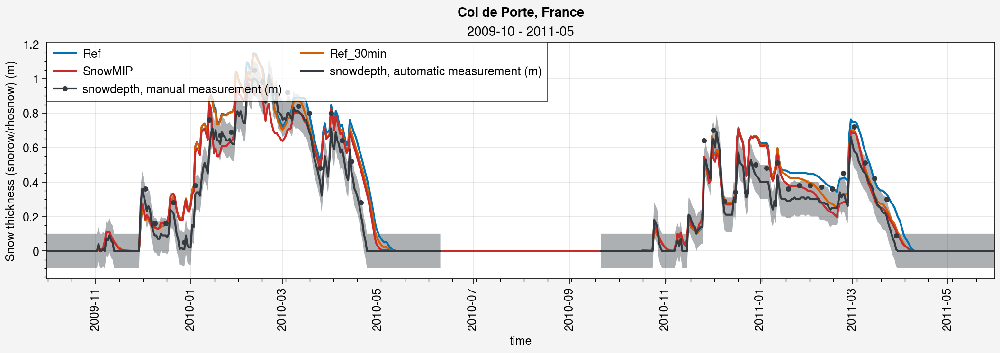

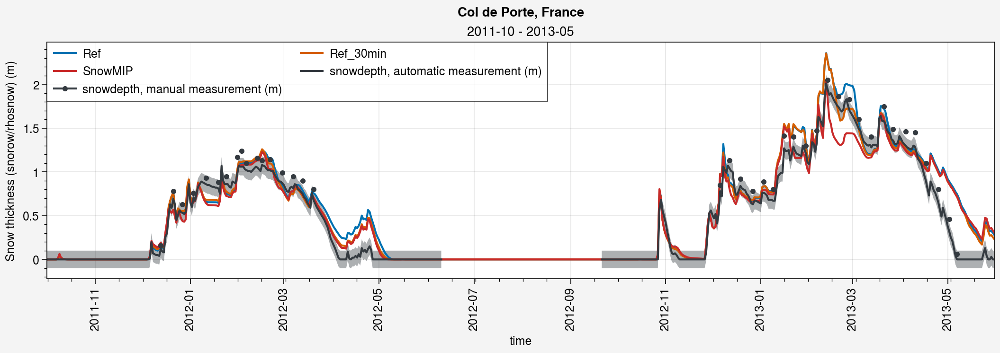

In [62]:
%matplotlib inline

color_obs = 'gray8'

for i in range(tot_year//gap):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=4, refwidth=10)

    if i*gap+gap < tot_year:
        period=slice(str(years[i*gap])+'-10',str(years[i*gap+gap])+'-05')
    else:
        period=slice(str(years[i*gap])+'-10',str(years[-1])+'-05')
    
    # Simus
    for ds_d, label in zip(ds_d_list, labels):
        axs[0].plot(ds_d.snd.sel(time=period), label=label)

    # SnowMIP
    axs[0].plot(ds_paul_d.snd.sel(time=period), label=label_paul, color='red9')
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values+0.1, axis=0),
        np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values-0.1, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.snd_auto.sel(time=period), shadedata=shadedata, color=color_obs)
    axs[0].plot(ds_d_eval_menard2019.snd_man.sel(time=period), marker='.', color=color_obs)

    # Veg
    # axs[0].plot(ds_d_list[0].vegHeight.sel(time=period), label='vegHeight', color='k', alpha=0.5)
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=period.start+' - '+period.stop)
    
    fig.suptitle(site_longname)


### SWE

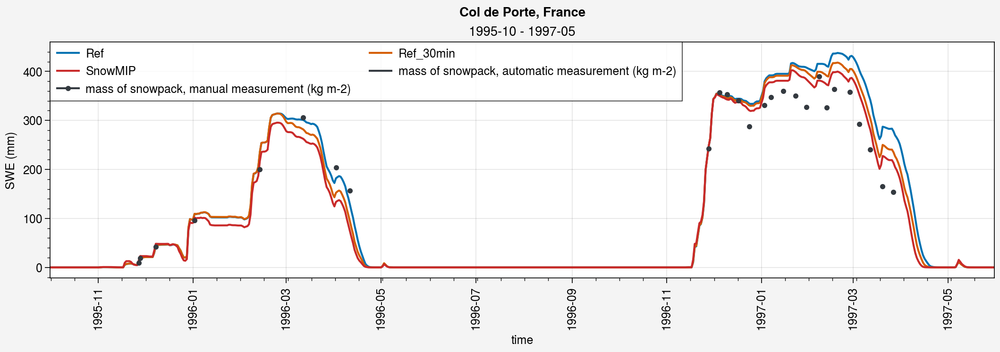

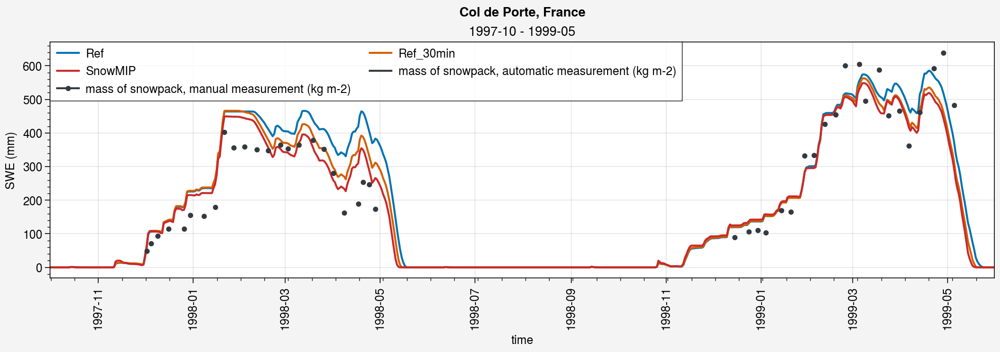

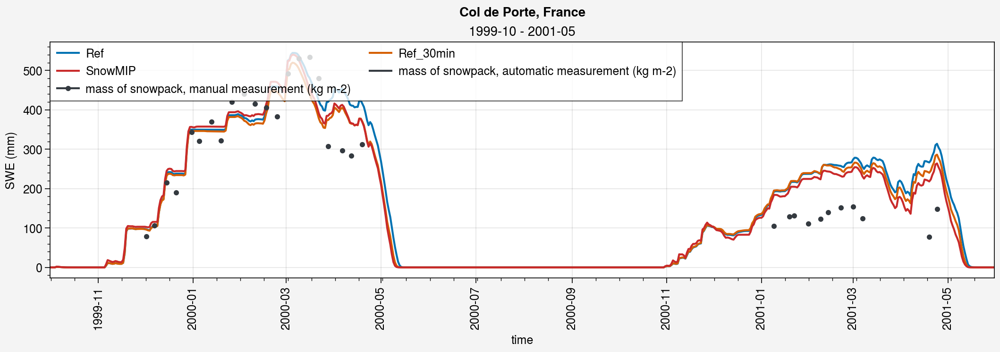

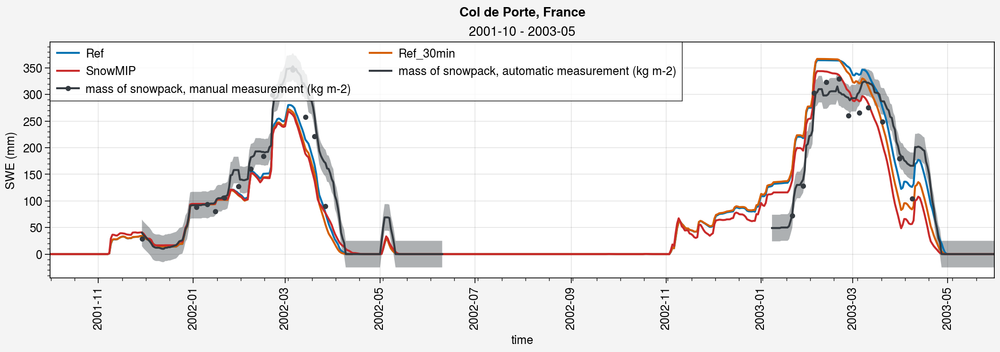

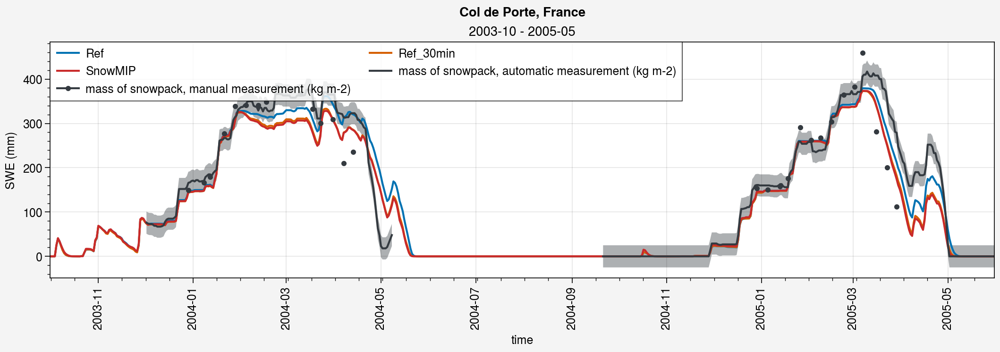

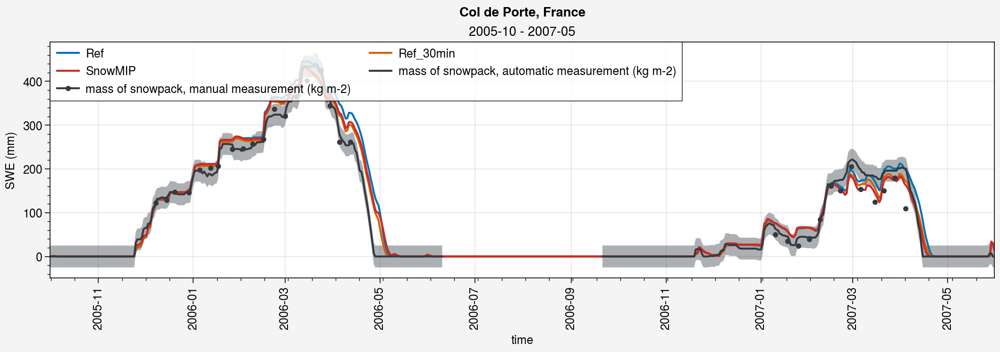

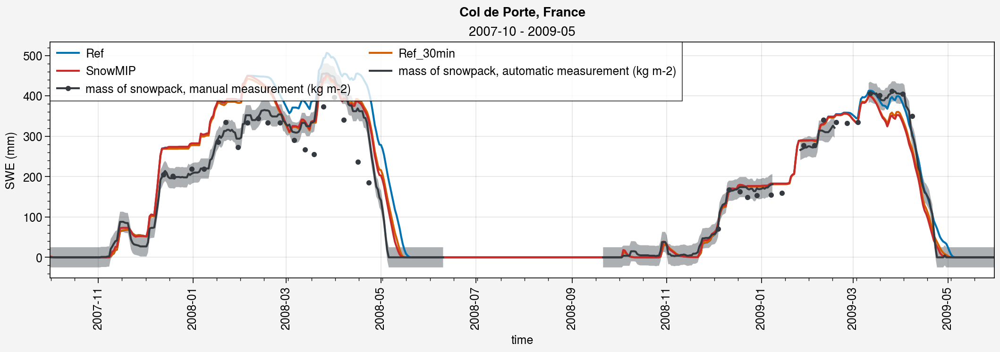

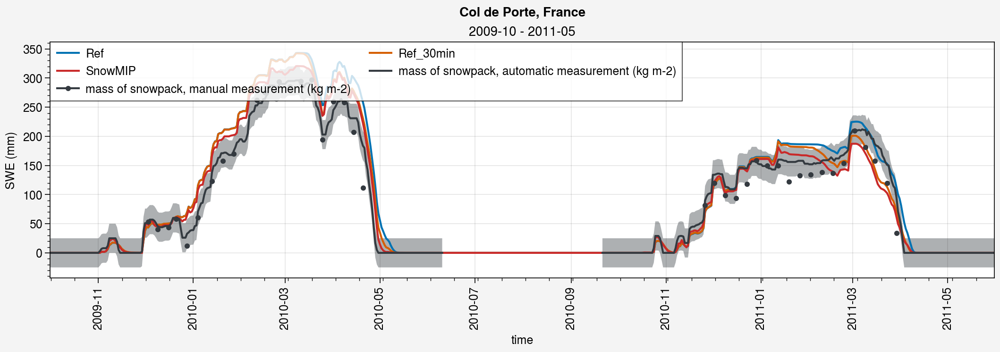

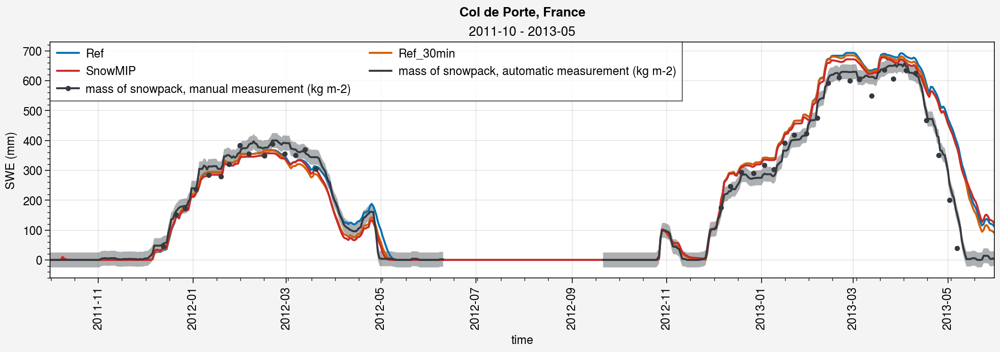

In [63]:
%matplotlib inline

color_obs = 'gray8'

for i in range(tot_year//gap):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=4, refwidth=10)

    if i*gap+gap < tot_year:
        period=slice(str(years[i*gap])+'-10',str(years[i*gap+gap])+'-05')
    else:
        period=slice(str(years[i*gap])+'-10',str(years[-1])+'-05')
    
    # Simus
    for ds_d, label in zip(ds_d_list, labels):
        axs[0].plot(ds_d.snw.sel(time=period), label=label)

    # SnowMIP
    axs[0].plot(ds_paul_d.snw.sel(time=period), label=label_paul, color='red9')
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.snw_auto.sel(time=period).values+25, axis=0),
        np.expand_dims(ds_d_eval_menard2019.snw_auto.sel(time=period).values-25, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.snw_auto.sel(time=period), shadedata=shadedata, color=color_obs)
    axs[0].plot(ds_d_eval_menard2019.snw_man.sel(time=period), marker='.', color=color_obs)
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=period.start+' - '+period.stop, ylabel='SWE (mm)')
    
    fig.suptitle(site_longname)


### Albedo

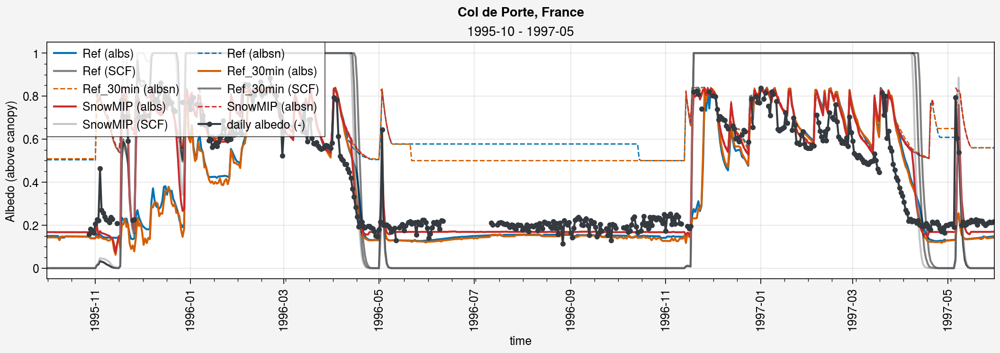

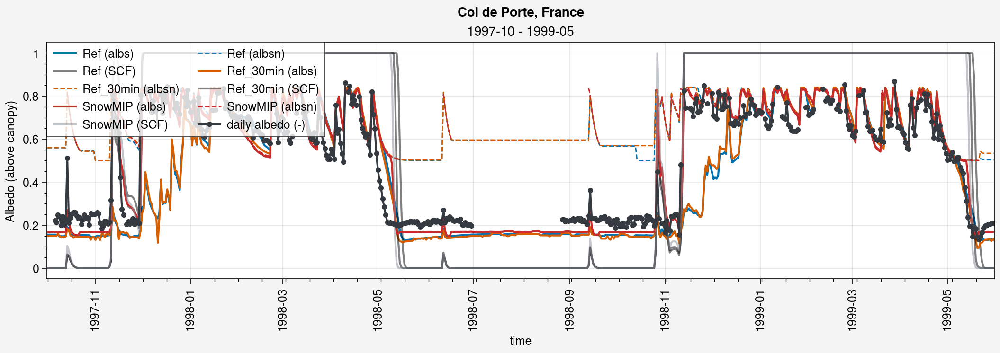

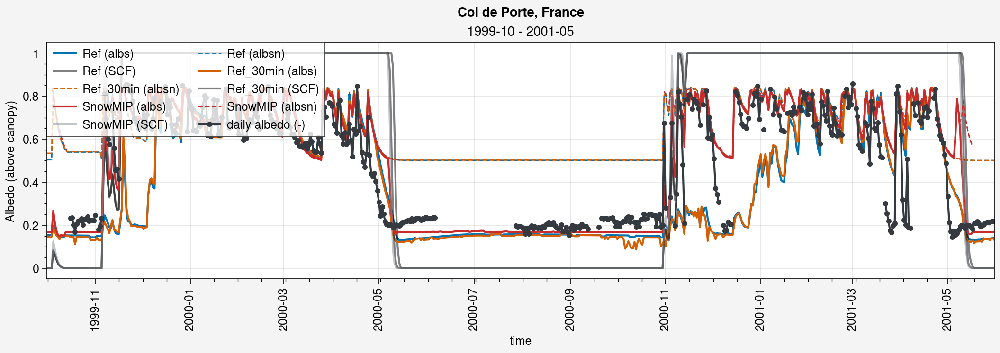

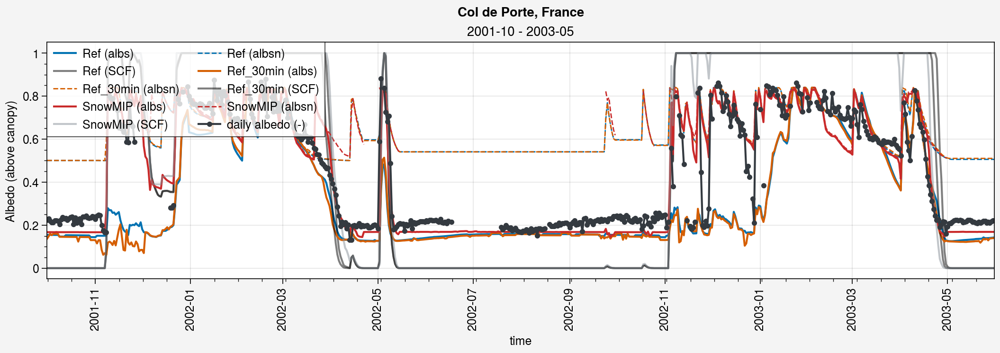

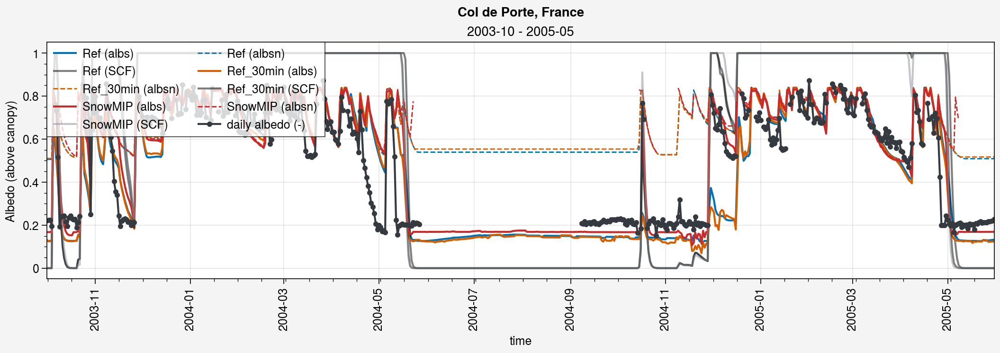

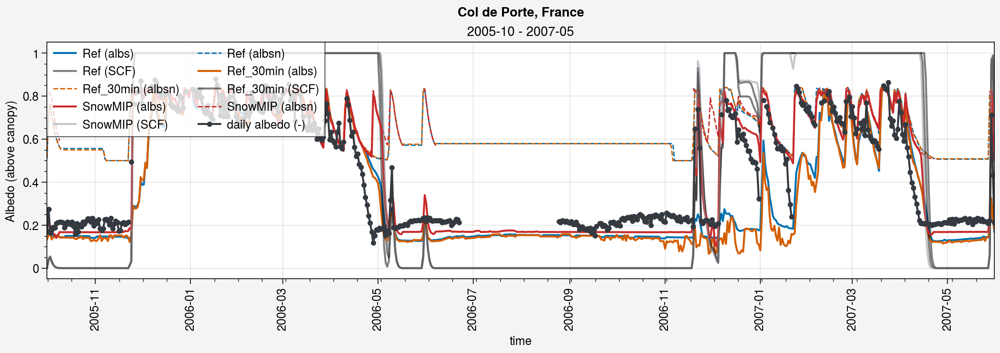

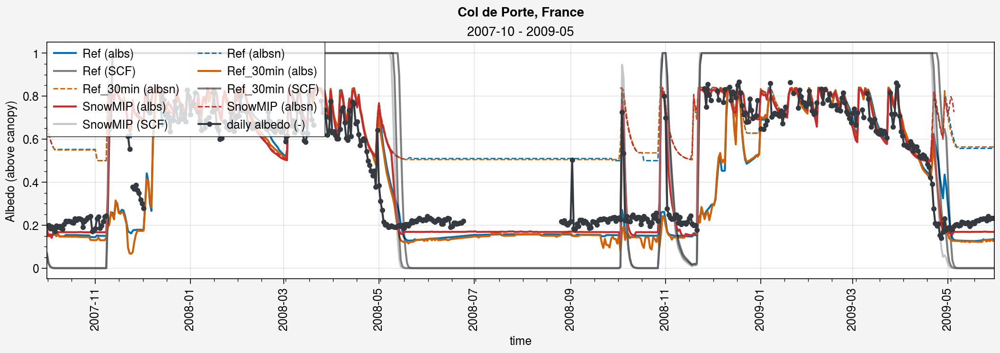

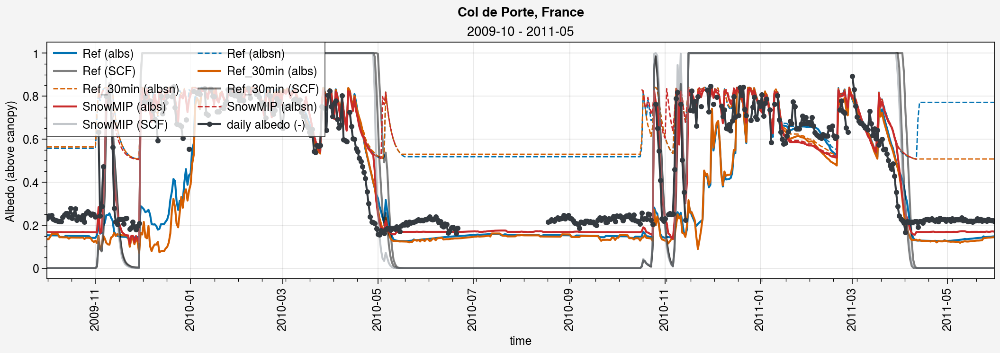

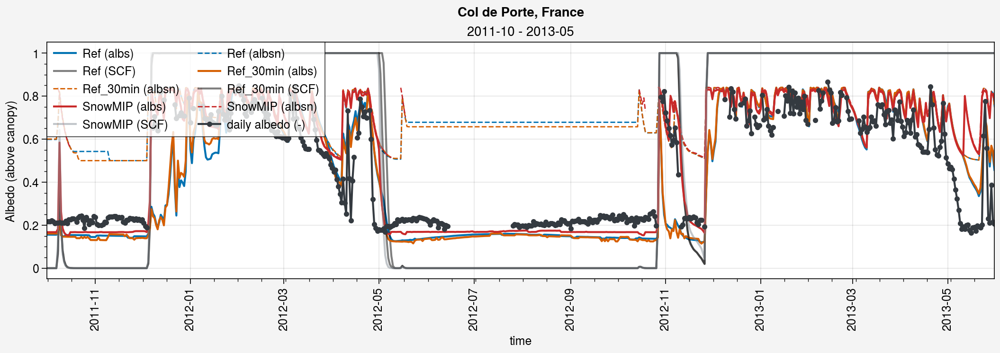

In [64]:
%matplotlib inline

color_obs = 'gray8'

for i in range(tot_year//gap):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=4, refwidth=10)

    if i*gap+gap < tot_year:
        period=slice(str(years[i*gap])+'-10',str(years[i*gap+gap])+'-05')
    else:
        period=slice(str(years[i*gap])+'-10',str(years[-1])+'-05')
    
    # Simus
    k = 0
    for ds_d, label in zip(ds_d_list, labels):
        axs[0].plot(ds_d.albs.sel(time=period), label=label+' (albs)', color='C'+str(k))
        axs[0].plot(ds_d.albsn.sel(time=period), label=label+' (albsn)', color='C'+str(k), ls='--', lw=1)
        axs[0].plot(ds_d.snc.sel(time=period), label=label+' (SCF)', color='k', alpha=0.5)
        
        k+=1

    # SnowMIP
    axs[0].plot(ds_paul_d.albs.sel(time=period), label=label_paul+' (albs)', color='red9')
    axs[0].plot(ds_paul_d.albsn.sel(time=period), label=label_paul+' (albsn)', color='red9', ls='--', lw=1)
    axs[0].plot(ds_paul_d.snc.sel(time=period), label=label_paul+' (SCF)', color='gray6', alpha=0.5)
    
    # Obs
    axs[0].plot(ds_d_eval_menard2019.albs.sel(time=period), marker='.', color=color_obs)
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=period.start+' - '+period.stop, ylabel='Albedo (above canopy)')
    
    fig.suptitle(site_longname)


### Surface Temperature

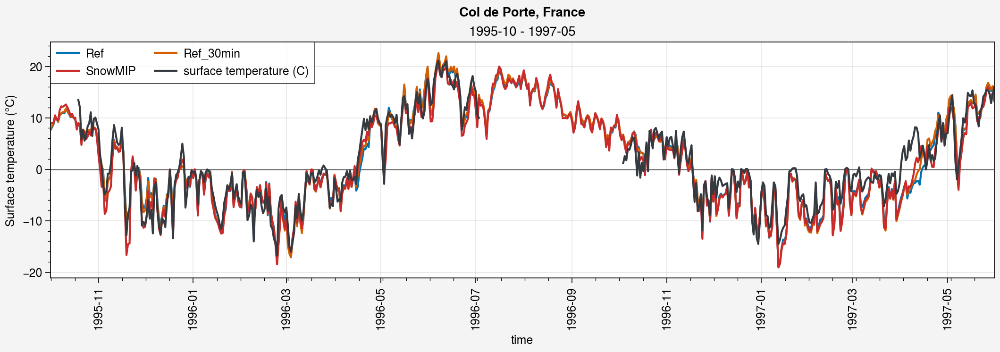

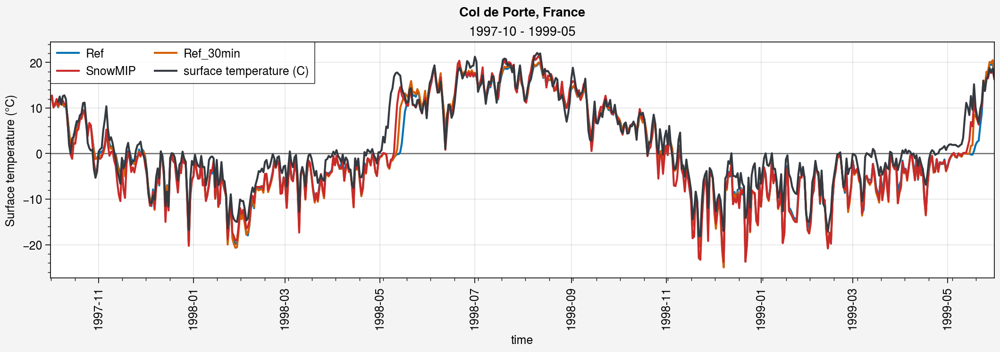

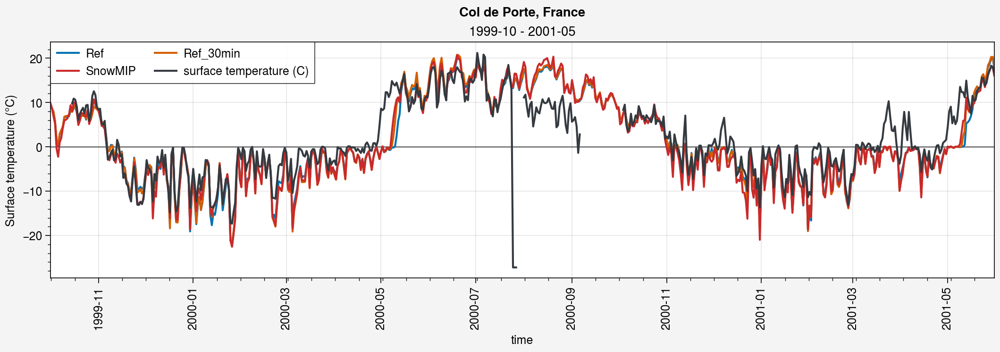

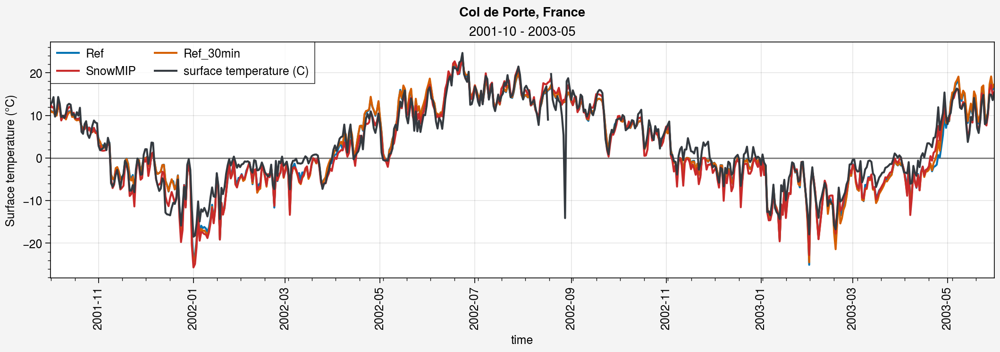

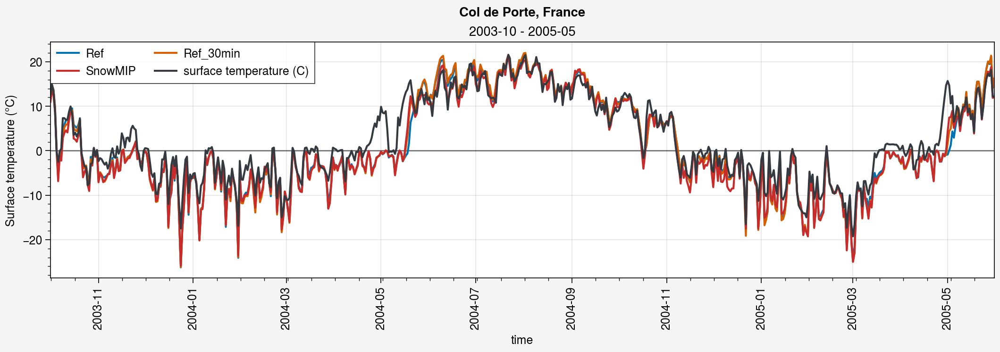

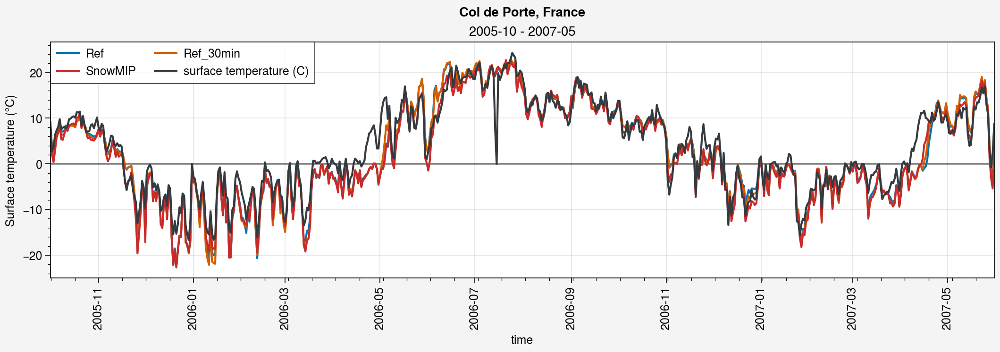

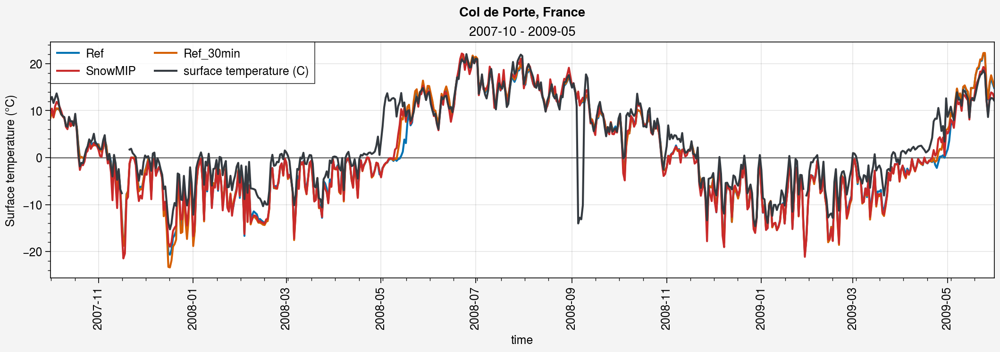

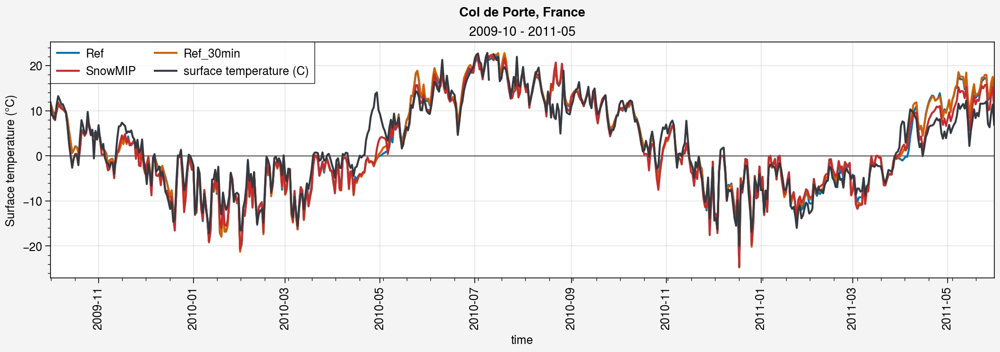

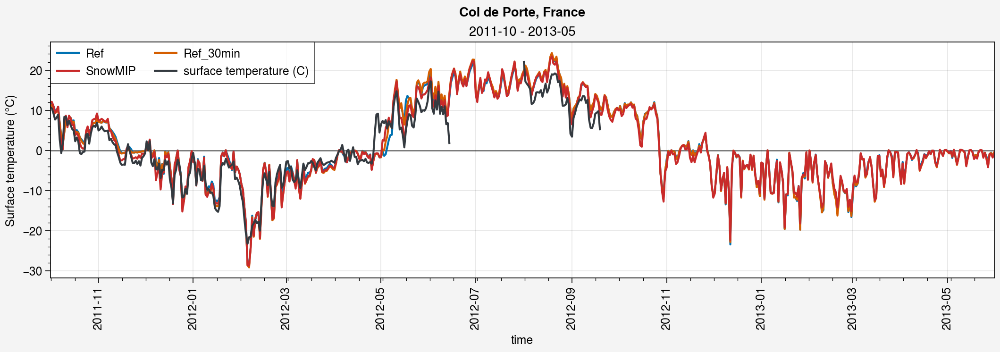

In [65]:
%matplotlib inline

color_obs = 'gray8'

for i in range(tot_year//gap):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=4, refwidth=10)

    if i*gap+gap < tot_year:
        period=slice(str(years[i*gap])+'-10',str(years[i*gap+gap])+'-05')
    else:
        period=slice(str(years[i*gap])+'-10',str(years[-1])+'-05')
    
    # Simus
    for ds_d, label in zip(ds_d_list, labels):
        axs[0].plot(ds_d.ts.sel(time=period)-273.15, label=label)

    # SnowMIP
    axs[0].plot(ds_paul_d.ts.sel(time=period)-273.15, label=label_paul, color='red9')
    
    # Obs
    axs[0].plot(ds_d_eval_menard2019.ts.sel(time=period), color=color_obs)
    axs[0].hlines(0, ds_d.ts.sel(time=period).time[0], ds_d.ts.sel(time=period).time[-1], c='k', lw=1, alpha=0.5)
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=period.start+' - '+period.stop, ylabel='Surface temperature (°C)')
    
    fig.suptitle(site_longname)


### Soil Temperature

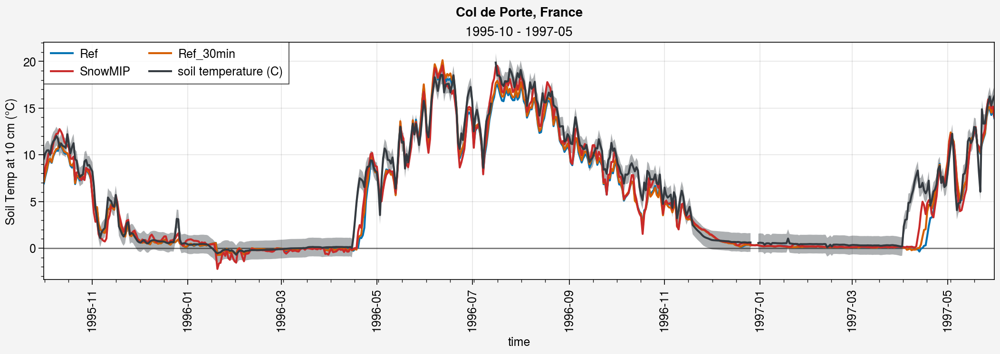

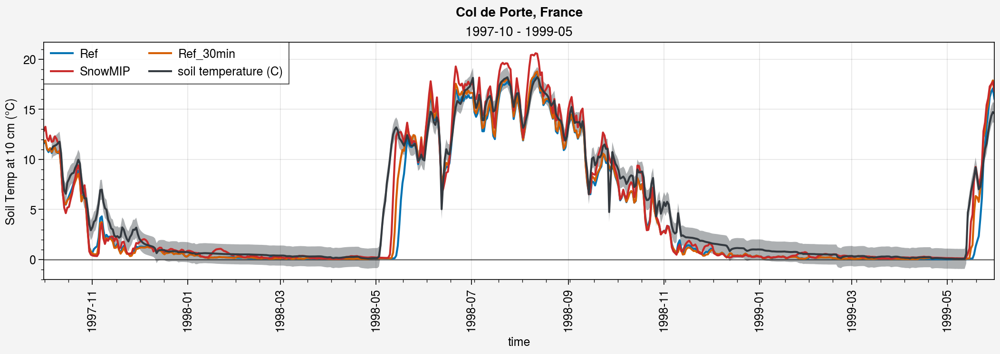

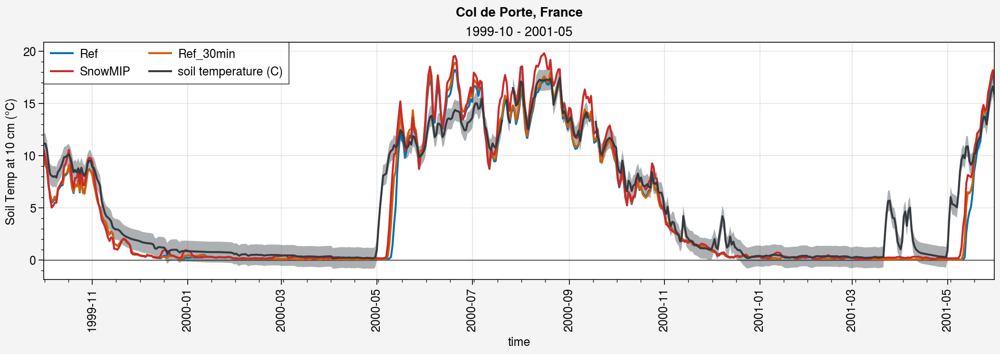

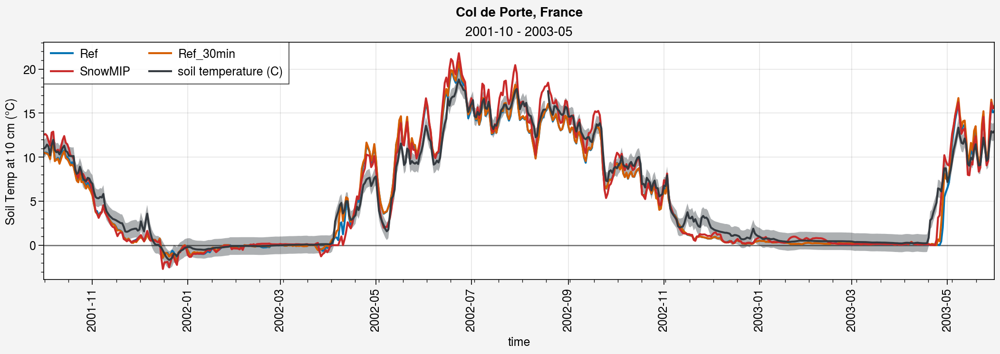

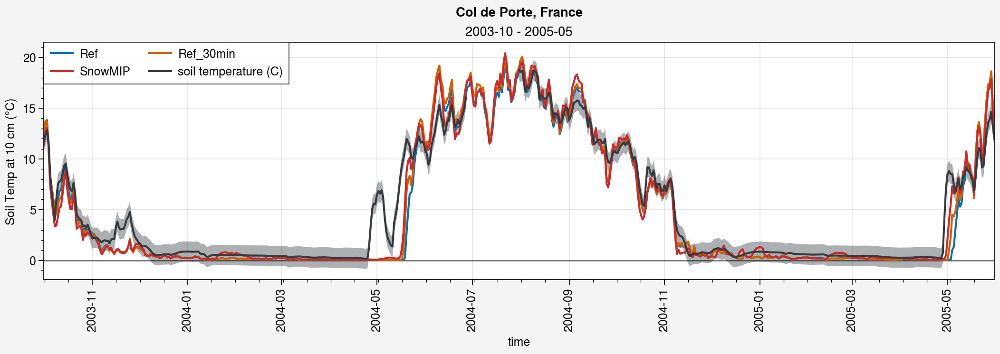

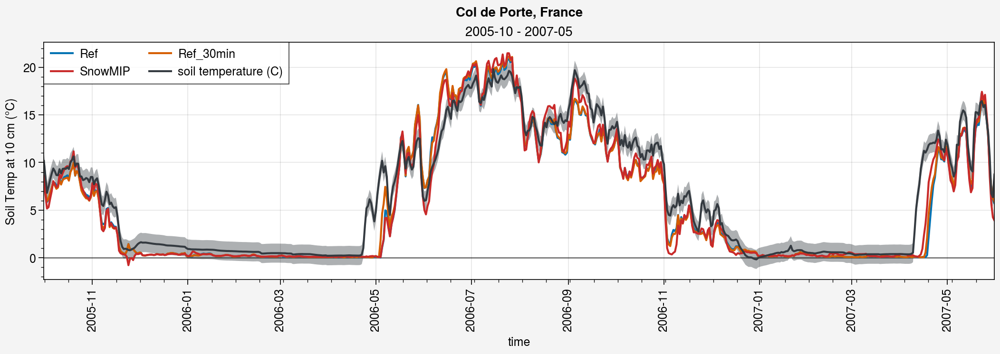

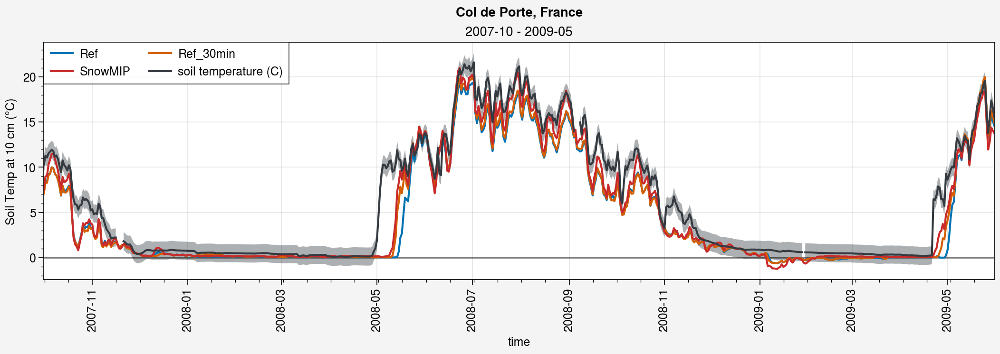

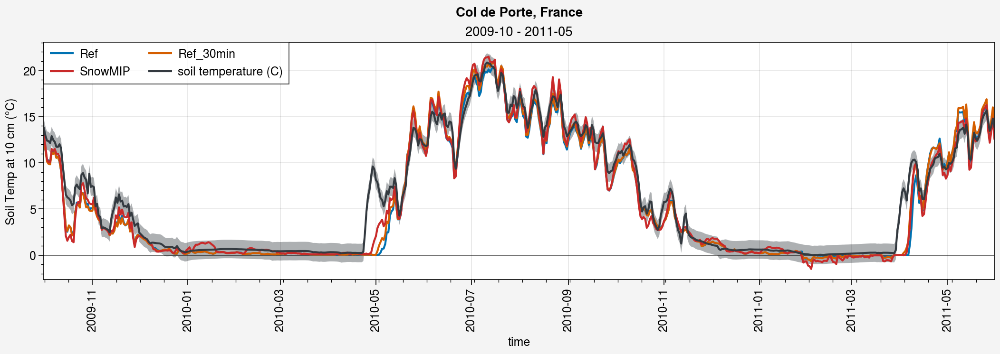

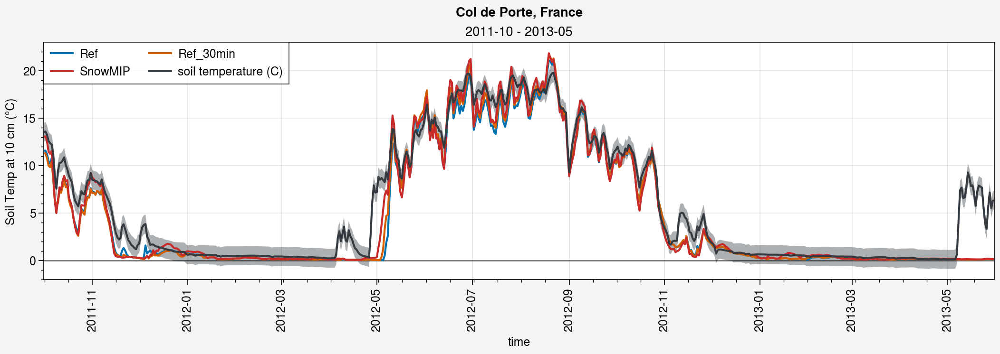

In [66]:
%matplotlib inline

color_obs = 'gray8'

for i in range(tot_year//gap):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=4, refwidth=10)

    if i*gap+gap < tot_year:
        period=slice(str(years[i*gap])+'-10',str(years[i*gap+gap])+'-05')
    else:
        period=slice(str(years[i*gap])+'-10',str(years[-1])+'-05')
    
    # Simus
    for ds_d, label in zip(ds_d_list, labels):
        # axs[0].plot(((ds_d.tsl.sel(time=period, layer=1)+ds_d.tsl.sel(time=period, layer=2))/2)-273.15, label=label)
        # axs[0].plot(((ds_d.tsl.sel(time=period).isel(layer=0)+ds_d.tsl.sel(time=period).isel(layer=1))/2)-273.15, label=label)
        axs[0].plot(ds_d.tsl.sel(time=period).interp(layer=ds_d_eval_menard2019.sdepth.values).sel(layer=0.1)-273.15, label=label)
    # axs[0].plot(((0.6*ds_paul_d['tsl:1'].sel(time=period)+0.4*ds_paul_d['tsl:2'].sel(time=period)))-273.15, label=label_paul, color='red9')
    axs[0].plot(ds_paul_d.tsl.sel(time=period).interp(layer=ds_d_eval_menard2019.sdepth.values).sel(layer=0.1)-273.15, label=label_paul, color='red9')
        
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.1)+1, axis=0),
        np.expand_dims(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.1)-1, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.1), shadedata=shadedata, color=color_obs)
    
    axs[0].hlines(0, ds_d.tsl.sel(time=period).time[0], ds_d.tsl.sel(time=period).time[-1], c='k', lw=1, alpha=0.5)
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=period.start+' - '+period.stop, ylabel='Soil Temp at 10 cm (°C)')
    
    fig.suptitle(site_longname)


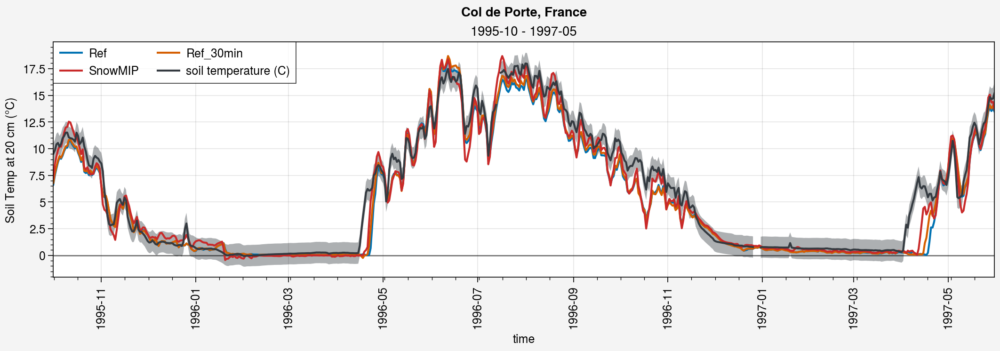

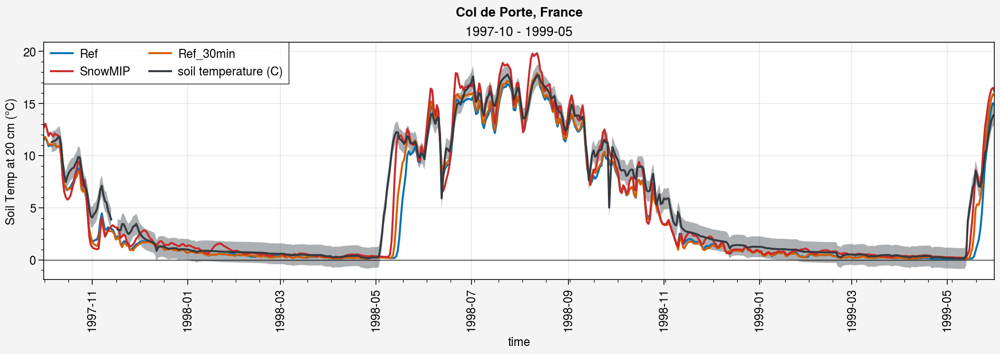

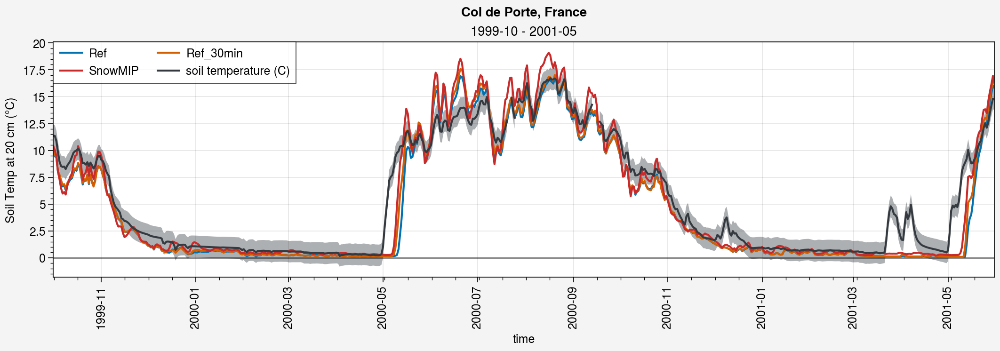

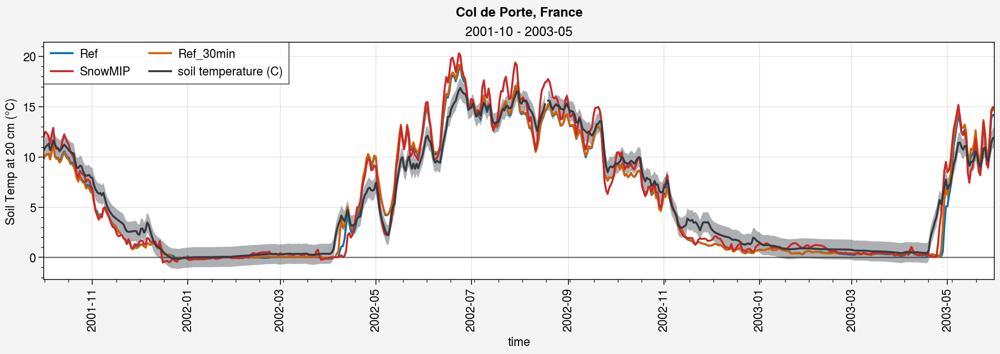

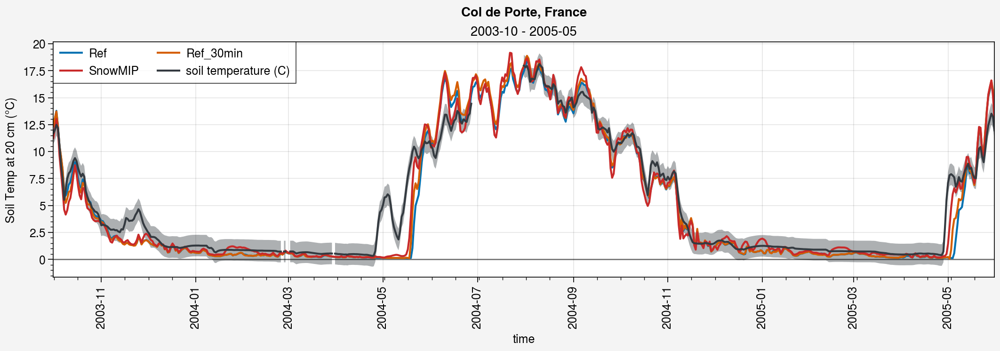

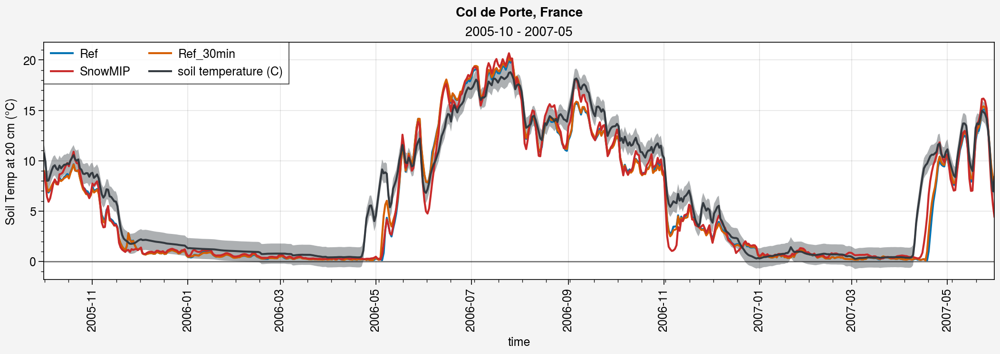

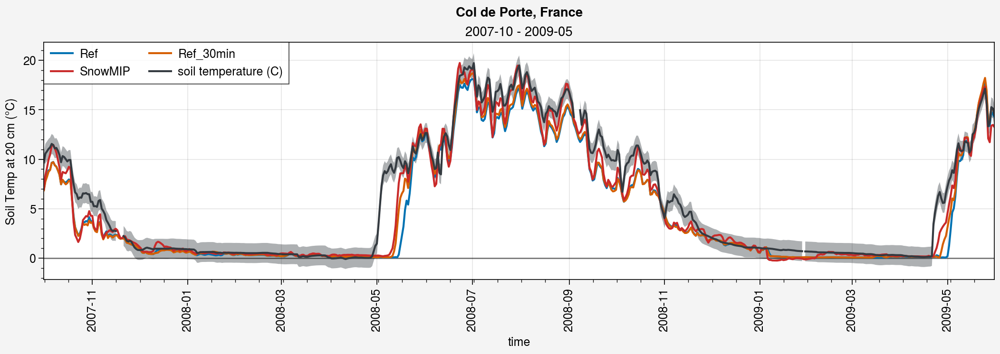

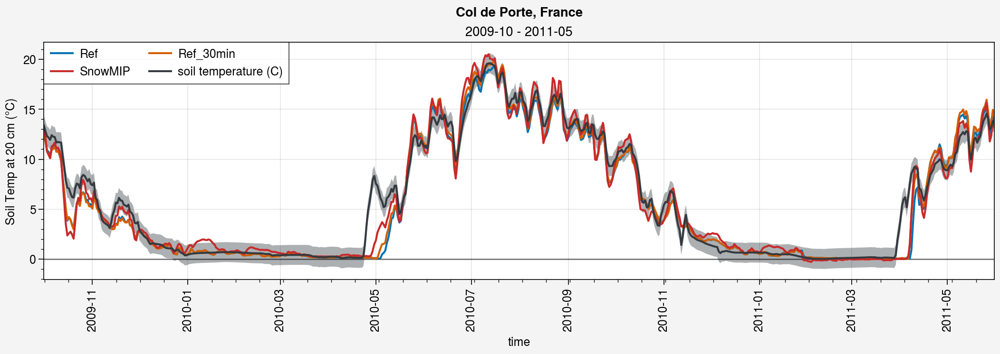

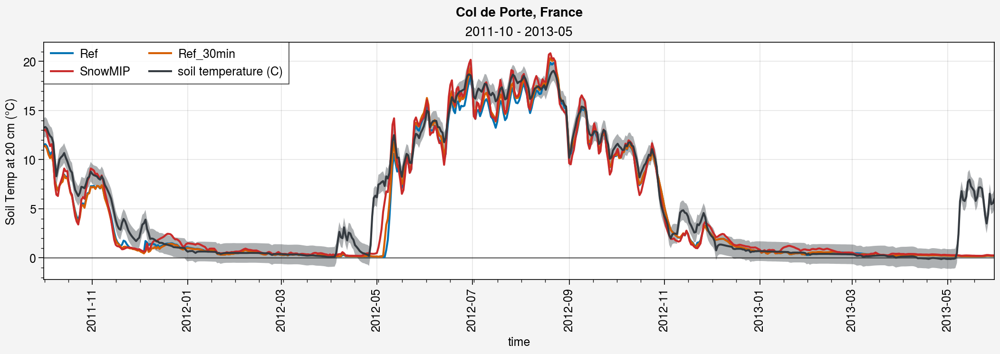

In [67]:
%matplotlib inline

color_obs = 'gray8'

for i in range(tot_year//gap):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=4, refwidth=10)

    if i*gap+gap < tot_year:
        period=slice(str(years[i*gap])+'-10',str(years[i*gap+gap])+'-05')
    else:
        period=slice(str(years[i*gap])+'-10',str(years[-1])+'-05')
    
    # Simus
    for ds_d, label in zip(ds_d_list, labels):
        # axs[0].plot(((ds_d.tsl.sel(time=period, layer=2)+ds_d.tsl.sel(time=period, layer=3))/2)-273.15, label=label)
        # axs[0].plot(((ds_d.tsl.sel(time=period).isel(layer=1)+ds_d.tsl.sel(time=period).isel(layer=2))/2)-273.15, label=label)
        axs[0].plot(ds_d.tsl.sel(time=period).interp(layer=ds_d_eval_menard2019.sdepth.values).sel(layer=0.2)-273.15, label=label)
    # axs[0].plot(ds_paul_d['tsl:2'].sel(time=period)-273.15, label=label_paul, color='red9')
    axs[0].plot(ds_paul_d.tsl.sel(time=period).interp(layer=ds_d_eval_menard2019.sdepth.values).sel(layer=0.2)-273.15, label=label_paul, color='red9')
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.2)+1, axis=0),
        np.expand_dims(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.2)-1, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.2), shadedata=shadedata, color=color_obs)
    
    axs[0].hlines(0, ds_d.tsl.sel(time=period).time[0], ds_d.tsl.sel(time=period).time[-1], c='k', lw=1, alpha=0.5)
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=period.start+' - '+period.stop, ylabel='Soil Temp at 20 cm (°C)')
    
    fig.suptitle(site_longname)


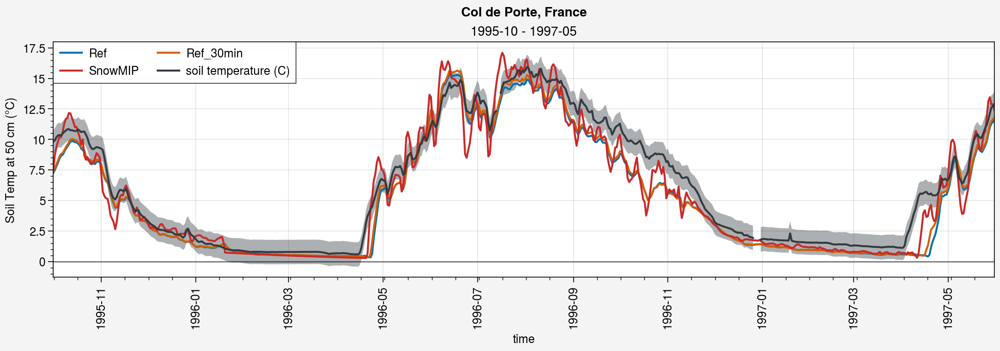

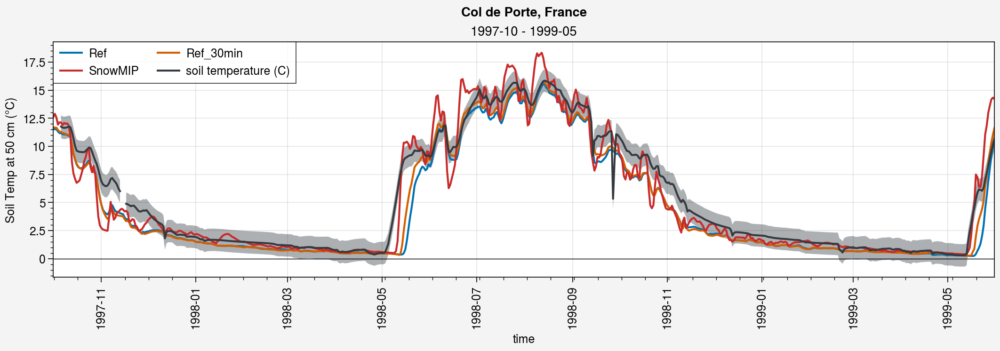

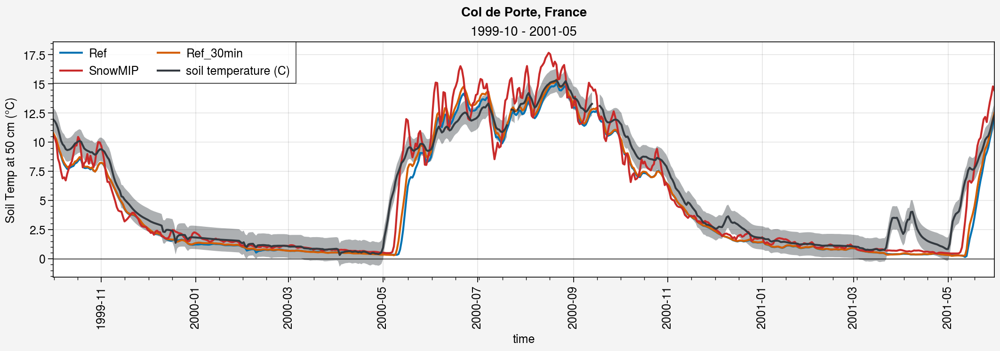

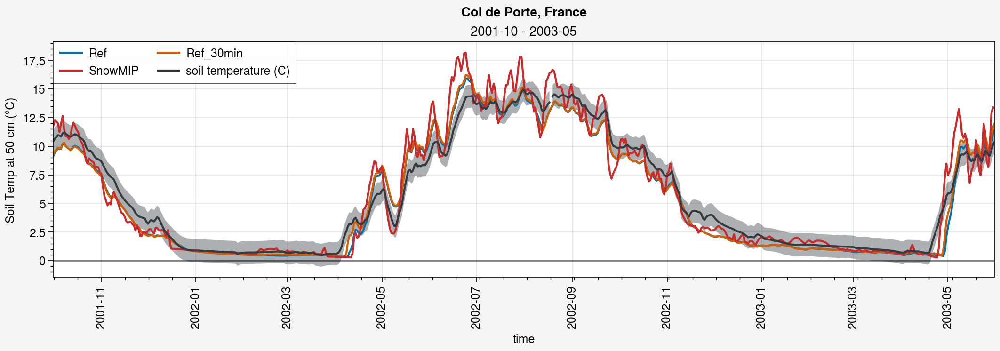

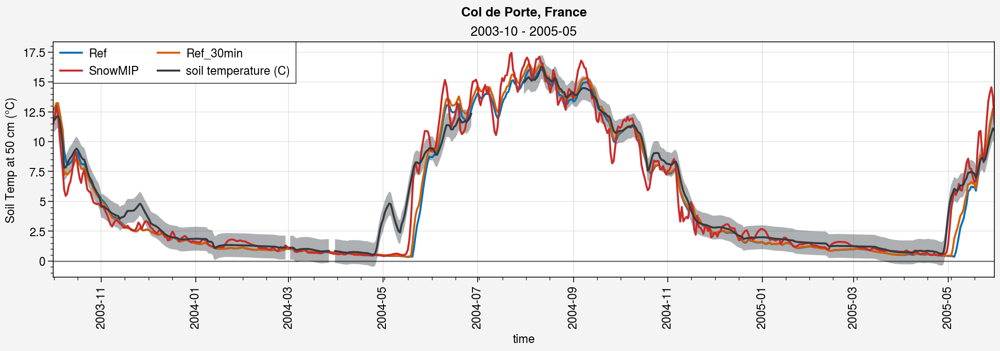

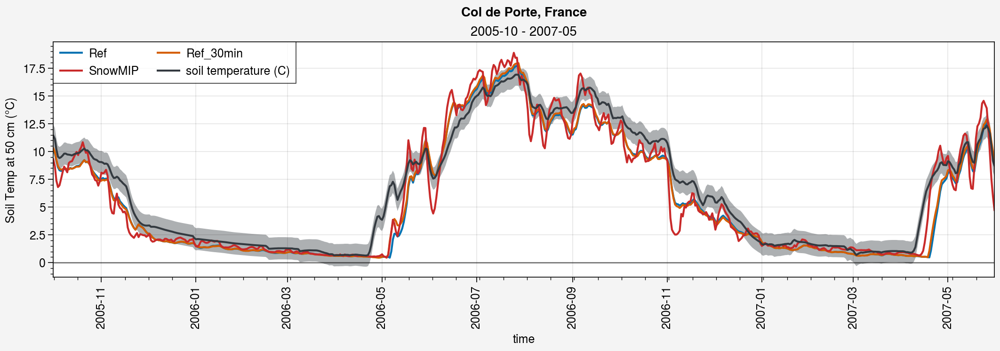

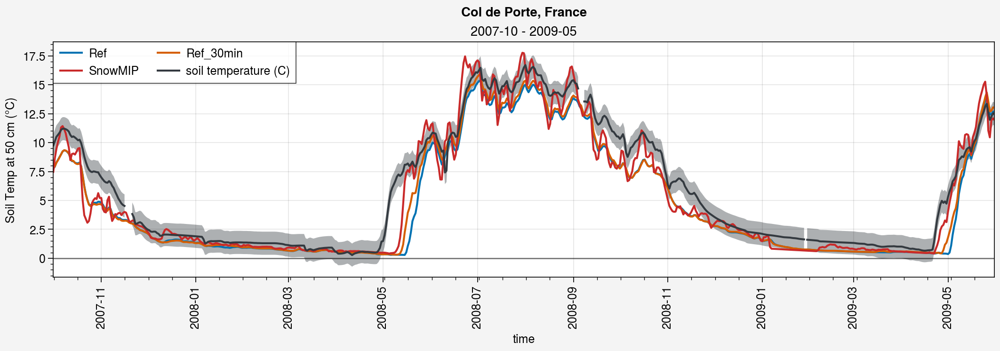

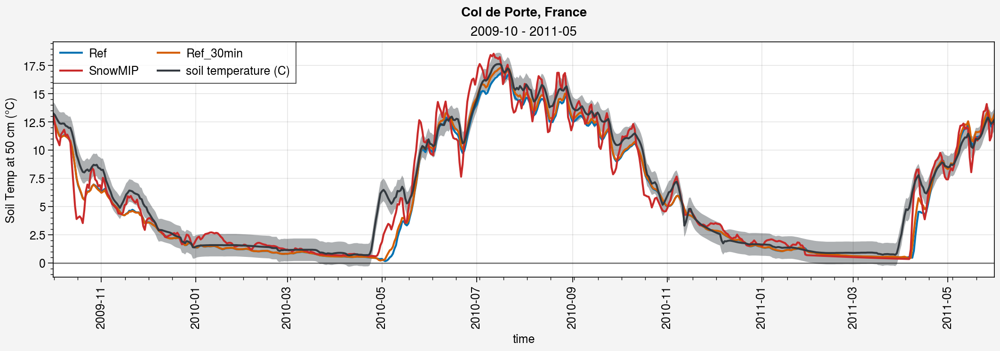

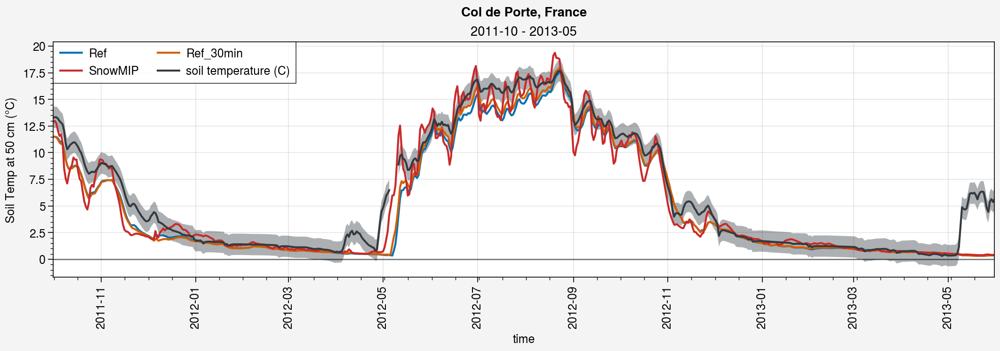

In [68]:
%matplotlib inline

color_obs = 'gray8'

for i in range(tot_year//gap):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=4, refwidth=10)

    if i*gap+gap < tot_year:
        period=slice(str(years[i*gap])+'-10',str(years[i*gap+gap])+'-05')
    else:
        period=slice(str(years[i*gap])+'-10',str(years[-1])+'-05')
    
    # Simus
    for ds_d, label in zip(ds_d_list, labels):
        # axs[0].plot(((ds_d.tsl.sel(time=period, layer=2)+ds_d.tsl.sel(time=period, layer=3))/2)-273.15, label=label)
        # axs[0].plot(((ds_d.tsl.sel(time=period).isel(layer=1)+ds_d.tsl.sel(time=period).isel(layer=2))/2)-273.15, label=label)
        axs[0].plot(ds_d.tsl.sel(time=period).interp(layer=ds_d_eval_menard2019.sdepth.values).sel(layer=0.5)-273.15, label=label)
    # axs[0].plot(ds_paul_d['tsl:2'].sel(time=period)-273.15, label=label_paul, color='red9')
    axs[0].plot(ds_paul_d.tsl.sel(time=period).interp(layer=ds_d_eval_menard2019.sdepth.values).sel(layer=0.5)-273.15, label=label_paul, color='red9')
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.5)+1, axis=0),
        np.expand_dims(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.5)-1, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.5), shadedata=shadedata, color=color_obs)
    
    
    axs[0].hlines(0, ds_d.tsl.sel(time=period).time[0], ds_d.tsl.sel(time=period).time[-1], c='k', lw=1, alpha=0.5)
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=period.start+' - '+period.stop, ylabel='Soil Temp at 50 cm (°C)')
    
    fig.suptitle(site_longname)
